# Load Necessary Library

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import os
from glob import glob
from datetime import datetime
import cv2

from torch.utils.data import Dataset
from torchvision.datasets import ImageFolder
from PIL import Image
import torch

from torchvision import transforms
from torch.utils.data import random_split
from torch.utils.data import DataLoader
from torch import nn, optim
from torchsummary import summary
import torch.nn.functional as F

# Setting Device & Prerprocessing Dataset

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device 

'cuda'

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/dataset/oxford_pet/annotations/list.txt', skiprows=6, delimiter=' ', header=None)
df.columns = ['file_name', 'id', 'species', 'breed']
df.head()

,file_name,id,species,breed
0,Abyssinian_100,1,1,1
1,Abyssinian_101,1,1,1
2,Abyssinian_102,1,1,1
3,Abyssinian_103,1,1,1
4,Abyssinian_104,1,1,1


In [ ]:
image_dir = '/content/drive/MyDrive/dataset/oxford_pet/images/'
mask_dir = '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/'

In [ ]:
image_files = glob(image_dir + '*.jpg')
mask_files = glob(mask_dir + '*.png')
len(image_files), len(mask_files)

(7378, 7390)

In [ ]:
mask_path = []
i = 0
for idx, img_file in enumerate(image_files):
    mask = img_file.replace(image_dir, mask_dir).replace('jpg', 'png')
    if mask in mask_files:
        mask_path.append(mask)
    else:
        image_files.pop(idx - i)
        i += 1

len(image_files), len(mask_path)

(7378, 7378)

In [ ]:
image_files[:10], mask_path[:10]

(['/content/drive/MyDrive/dataset/oxford_pet/images/shiba_inu_12.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/wheaten_terrier_137.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Bengal_88.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/keeshond_170.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/newfoundland_107.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/japanese_chin_106.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Birman_49.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Sphynx_90.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Persian_126.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/japanese_chin_105.jpg'],
 ['/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/shiba_inu_12.png',
  '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/wheaten_terrier_137.png',
  '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/Bengal_88.png',
  '/content/drive/MyDr

# Define Dataset Function & Visualization Dataset

In [ ]:
class Oxford_Segmentation_Dataset(Dataset):
    def __init__(self, img_dir, mask_path, transform=None, target_transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform
        self.mask_path = mask_path
        
    def __len__(self):
        return len(self.img_dir)

    def __getitem__(self, idx):
        img_path = self.img_dir[idx]
        image = Image.open(img_path)
        mask_path = self.mask_path[idx]
        mask = np.array(Image.open(mask_path))
        mask -= 1
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            mask = self.target_transform(mask)
            mask = np.array(mask)
            mask = torch.tensor(mask).type(torch.LongTensor)

        return image, mask

In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

target_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
])

dataset = Oxford_Segmentation_Dataset(
    img_dir=image_files, 
    mask_path=mask_path, 
    transform=transform, 
    target_transform=target_transform
)

train_size = int(len(dataset) * 0.9)
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [ ]:
train_batch_size = 32
val_batch_size = 16

train_loader = DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=val_batch_size, shuffle=False, num_workers=2)

In [ ]:
for idx, sample_batch in enumerate(train_loader):
    print(sample_batch[0].shape)
    print(sample_batch[1].shape)
    print(sample_batch[0].dtype)
    print(sample_batch[1].dtype)
    print()
    break

torch.Size([32, 3, 224, 224])
torch.Size([32, 224, 224])
torch.float32
torch.int64



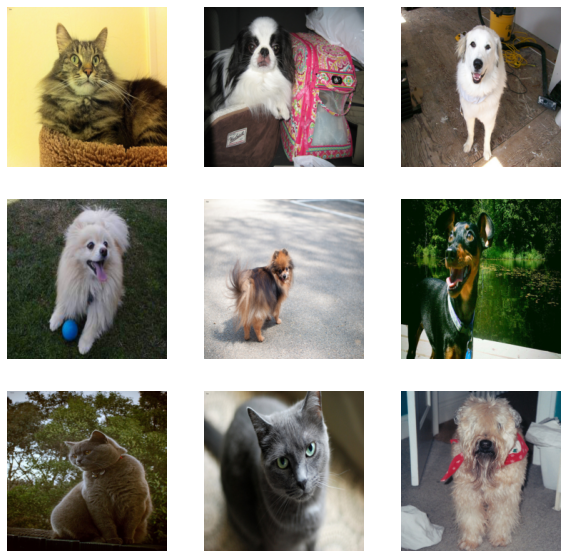

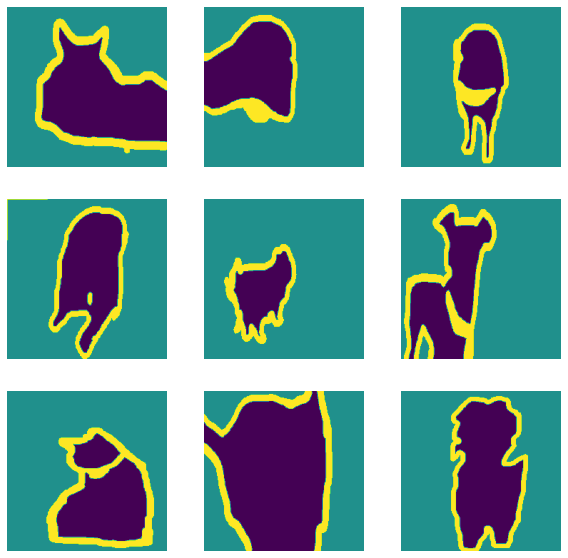

In [ ]:
sample = next(iter(val_loader))
plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(torch.permute(sample[0][i], (1, 2, 0)))
    plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(torch.squeeze(sample[1][i], 0))
    plt.axis('off')
plt.show()

# Implementation UNet

In [ ]:
class DConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.dconv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.dconv(x)


class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.max_pool = nn.MaxPool2d(2)

        self.enc1 = DConv(in_channels, 64)
        self.enc2 = DConv(64, 128)
        self.enc3 = DConv(128, 256)
        self.enc4 = DConv(256, 512)
        
        self.enc5 = nn.Conv2d(512, 1024, 3, 1, 1)
        self.dec5 = nn.Conv2d(1024, 512, 3, 1, 1)

        self.up_pool_4 = nn.ConvTranspose2d(512, 512, 2, 2, 0)
        self.dec4 = DConv(1024, 512)

        self.up_pool_3 = nn.ConvTranspose2d(512, 256, 2, 2, 0)
        self.dec3 = DConv(512, 256)

        self.up_pool_2 = nn.ConvTranspose2d(256, 128, 2, 2, 0)
        self.dec2 = DConv(256, 128)

        self.up_pool_1 = nn.ConvTranspose2d(128, 64, 2, 2, 0)
        self.dec1 = DConv(128, 64)

        self.conv = nn.Conv2d(64, out_channels, 1, 1, 0)
        
    def forward(self, x):
        enc1 = self.enc1(x)
        pool1 = self.max_pool(enc1)
        enc2 = self.enc2(pool1)
        pool2 = self.max_pool(enc2)
        enc3 = self.enc3(pool2)
        pool3 = self.max_pool(enc3)
        enc4 = self.enc4(pool3)
        pool4 = self.max_pool(enc4)
        
        enc5 = self.enc5(pool4)
        dec5 = self.dec5(enc5)

        up_pool4 = self.up_pool_4(dec5)
        cat4 = torch.cat((up_pool4, enc4), dim=1)
        dec4 = self.dec4(cat4)

        up_pool3 = self.up_pool_3(dec4)
        cat3 = torch.cat((up_pool3, enc3), dim=1)
        dec3 = self.dec3(cat3)

        up_pool2 = self.up_pool_2(dec3)
        cat2 = torch.cat((up_pool2, enc2), dim=1)
        dec2 = self.dec2(cat2)

        up_pool1 = self.up_pool_1(dec2)
        cat1 = torch.cat((up_pool1, enc1), dim=1)
        dec1 = self.dec1(cat1)

        out = self.conv(dec1)

        return out

# Define Iou & Dice Loss Function

In [ ]:
def iou(preds, targets):
    smooth = 1e-5

    preds = preds.detach().cpu().numpy()
    targets = targets.detach().cpu().numpy()

    intersection = np.sum(np.logical_and(targets, preds))
    union = np.sum(np.logical_or(targets, preds))
    iou_score = (torch.tensor(intersection) + smooth)  / (torch.tensor(union) + smooth)

    return iou_score

def dice_coef(preds, targets):
    smooth = 1e-5

    preds = preds.detach().cpu().numpy()
    targets = targets.detach().cpu().numpy()
    targets = np.expand_dims(targets, 1)
    
    intersection = np.sum(np.logical_and(targets, preds))
    union = np.sum(np.logical_or(targets, targets)) + np.sum(np.logical_or(preds, preds))
    dice = (2 * torch.tensor(intersection) + smooth) / (torch.tensor(union) + smooth )
    return dice
    

def dice_loss(preds, targets):
    return 1 - dice_coef(preds, targets)

def bce_dice_loss(preds, targets):
    loss_fn = nn.CrossEntropyLoss()
    loss = 1. * loss_fn(preds, targets) + 1. * dice_loss(preds, targets)

    return loss

# Setting Model & Optimizer & Loss Function

In [ ]:
lr = 1e-2
epochs = 30

model = UNet(3, 3).to(device)
model_name = type(model).__name__
summary(model, (3, 224, 224))

loss_fn = bce_dice_loss

optimizer = optim.Adam(model.parameters(), lr=lr)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,728
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
            Conv2d-4         [-1, 64, 224, 224]          36,864
       BatchNorm2d-5         [-1, 64, 224, 224]             128
              ReLU-6         [-1, 64, 224, 224]               0
             DConv-7         [-1, 64, 224, 224]               0
         MaxPool2d-8         [-1, 64, 112, 112]               0
            Conv2d-9        [-1, 128, 112, 112]          73,728
      BatchNorm2d-10        [-1, 128, 112, 112]             256
             ReLU-11        [-1, 128, 112, 112]               0
           Conv2d-12        [-1, 128, 112, 112]         147,456
      BatchNorm2d-13        [-1, 128, 112, 112]             256
             ReLU-14        [-1, 128, 1

In [ ]:
# With some modifications, source is from https://github.com/Bjarten/early-stopping-pytorch

class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0, path='checkpoint.ckpt', trace_func=print):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
            path (str): Path for the checkpoint to be saved to.
                            Default: 'checkpoint.ckpt'
            trace_func (function): trace print function.
                            Default: print            
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.path = path
        self.trace_func = trace_func

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            self.trace_func(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            self.trace_func(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        
        filename = self.path.split('/')[-1]
        save_dir = os.path.dirname(self.path)
        torch.save(model, os.path.join(save_dir, f"val_loss-{val_loss}-{filename}"))
        self.val_loss_min = val_loss

# Define Training & Validation Function

In [ ]:
def train(epoch, model, train_loader, loss_fn, optimizer):
    print(f' Epoch: [{epoch}/{epochs}] - Train')
    model.train()
    current_loss = 0.0
    current_iou = 0.0
    for batch_idx, (images, mask) in enumerate(train_loader):
        images, mask = images.to(device), mask.to(device)

        outputs = model(images)

        loss = loss_fn(outputs, mask)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        _, preds = torch.max(outputs, 1)

        current_loss += loss.item()
        current_iou += iou(preds, mask)

        if (batch_idx + 1) % 50 == 0:
            train_loss = current_loss / 50
            train_iou = current_iou / 50
            print(f'Current Step: {batch_idx + 1} \tTrain Loss: {train_loss}, Train Iou: {train_iou}')

            plt.figure(figsize=(15, 15))
            plt.subplot(131)
            plt.imshow(torch.permute(images[0], (1, 2, 0)).detach().cpu().numpy())
            plt.title('Image')
            plt.axis('off')
            plt.subplot(132)
            plt.imshow(mask[0].detach().cpu().numpy())
            plt.title('Mask')
            plt.axis('off')
            plt.subplot(133)
            plt.imshow(preds[0].detach().cpu().numpy())
            plt.title('Predict')
            plt.axis('off')
            plt.show()

            current_loss = 0.0
            current_iou = 0.0

    return train_loss, train_iou

def validation(epoch, model, val_loader, loss_fn):
    print(f' Epoch: [{epoch}/{epochs}] - Validation')
    with torch.no_grad():
        model.eval()
        val_loss = 0.0
        val_iou = 0.0
        for val_idx, (val_images, val_mask) in enumerate(val_loader):

            val_images, val_mask = val_images.to(device), val_mask.to(device)
            val_outputs = model(val_images)

            val_loss += loss_fn(val_outputs, val_mask)
            
            _, val_preds = torch.max(val_outputs, 1)

            val_iou += iou(val_preds, val_mask)

        val_epoch_loss = val_loss / len(val_loader)
        val_epoch_iou = val_iou / len(val_loader)

    print(f'Validation step: Val Loss: {val_epoch_loss}, Val Iou: {val_epoch_iou}')

    plt.figure(figsize=(15, 15))
    plt.subplot(131)
    plt.imshow(torch.permute(val_images[0], (1, 2, 0)).detach().cpu().numpy())
    plt.title('Image')
    plt.axis('off')
    plt.subplot(132)
    plt.imshow(val_mask[0].detach().cpu().numpy())
    plt.title('Mask')
    plt.axis('off')
    plt.subplot(133)
    plt.imshow(val_preds[0].detach().cpu().numpy())
    plt.title('Predict')
    plt.axis('off')
    plt.show()

    return val_epoch_loss, val_epoch_iou

In [ ]:
log_dir = f"runs/{datetime.now().isoformat(timespec='seconds')}-{model_name}"
model_path = os.path.join(log_dir, 'models')
os.makedirs(model_path, exist_ok=True)

# Training

 Epoch: [1/30] - Train
Current Step: 50 	Train Loss: 0.6951234412193298, Train Iou: 0.6688719391822815


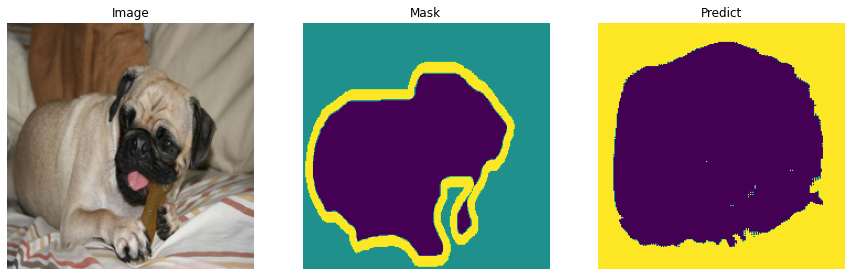

Current Step: 100 	Train Loss: 0.6133891844749451, Train Iou: 0.6912049055099487


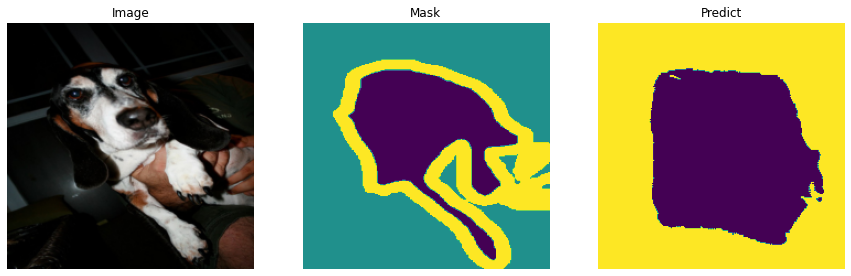

Current Step: 150 	Train Loss: 0.5470632541179657, Train Iou: 0.7374278903007507


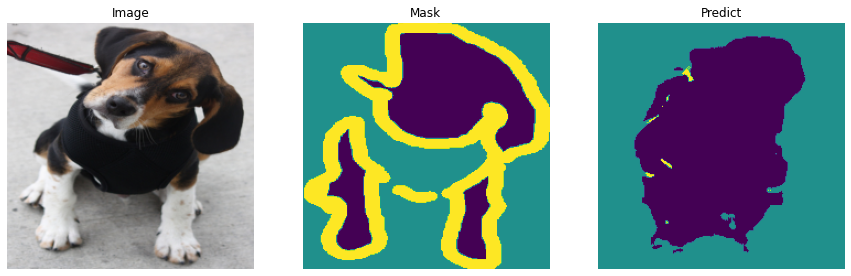

Current Step: 200 	Train Loss: 0.5233844101428986, Train Iou: 0.7437278628349304


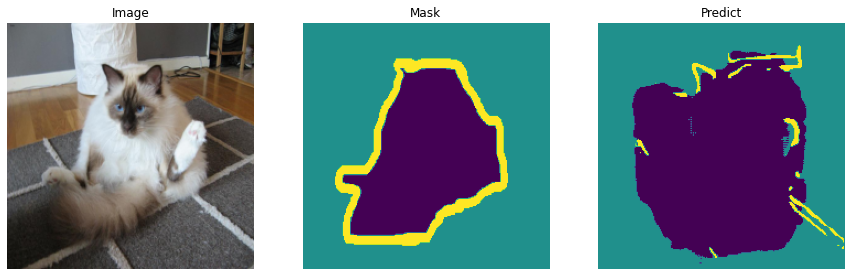

 Epoch: [1/30] - Validation
Validation step: Val Loss: 0.5384009480476379, Val Iou: 0.7213795185089111


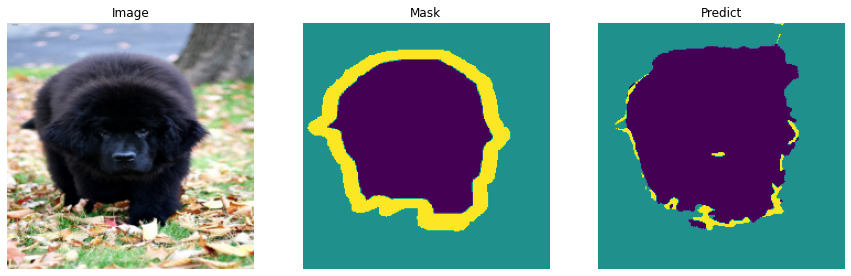

Validation loss decreased (inf --> 0.538401).  Saving model ...
 Epoch: [2/30] - Train
Current Step: 50 	Train Loss: 0.5154522025585174, Train Iou: 0.7501758337020874


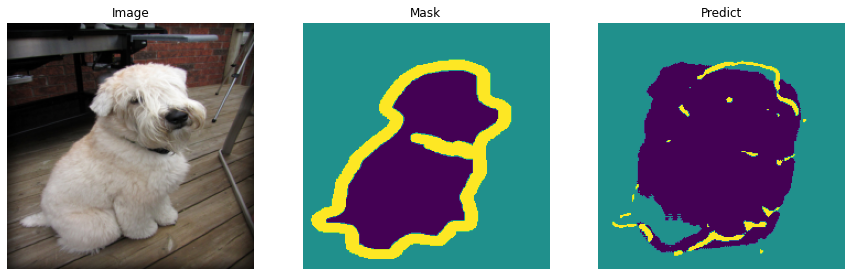

Current Step: 100 	Train Loss: 0.46780952692031863, Train Iou: 0.7671353220939636


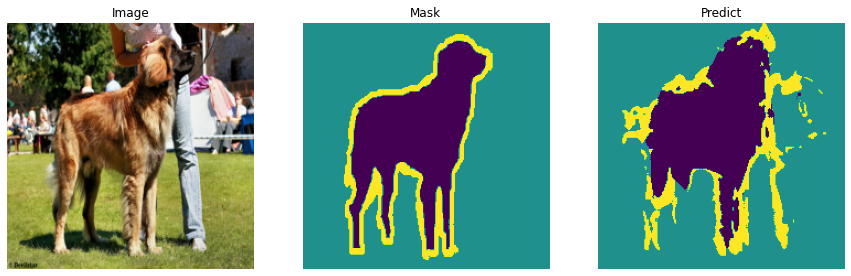

Current Step: 150 	Train Loss: 0.45088366985321043, Train Iou: 0.7767933011054993


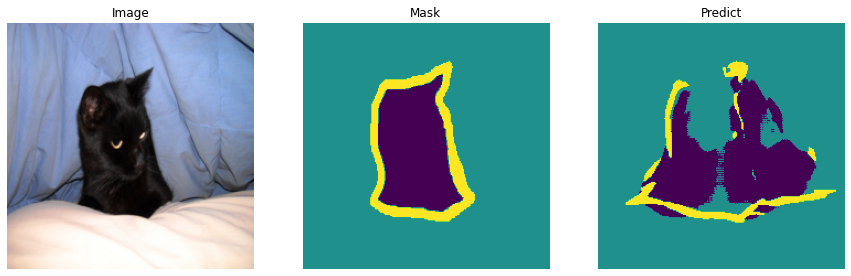

Current Step: 200 	Train Loss: 0.4357459843158722, Train Iou: 0.785001814365387


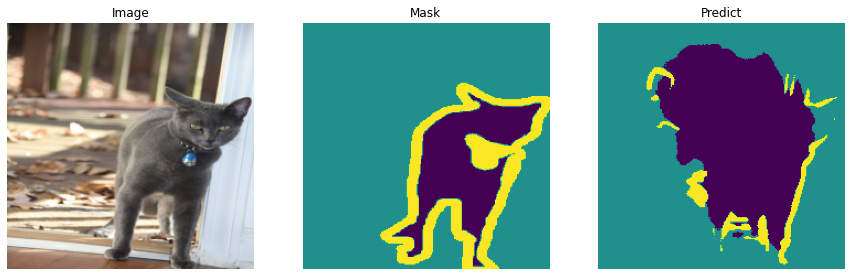

 Epoch: [2/30] - Validation
Validation step: Val Loss: 0.4616925120353699, Val Iou: 0.7972265481948853


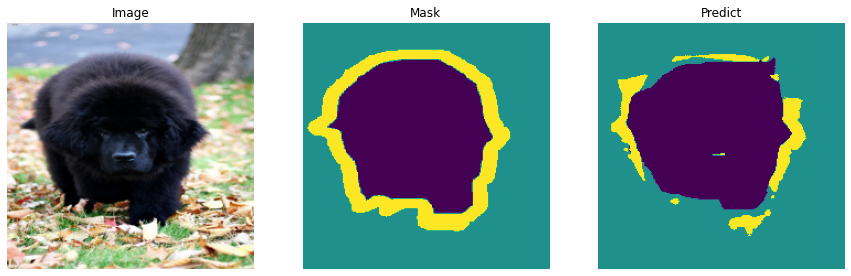

Validation loss decreased (0.538401 --> 0.461693).  Saving model ...
 Epoch: [3/30] - Train
Current Step: 50 	Train Loss: 0.42106723666191104, Train Iou: 0.7941673994064331


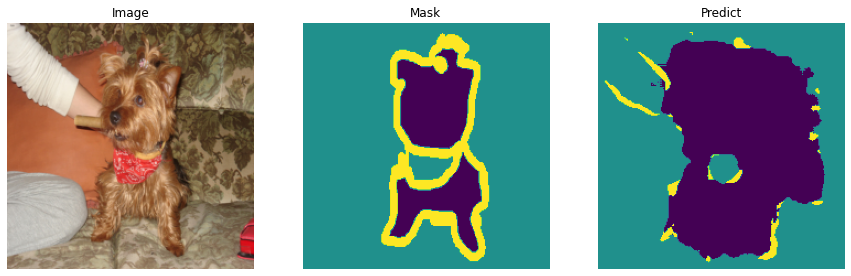

Current Step: 100 	Train Loss: 0.4226608508825302, Train Iou: 0.7971186637878418


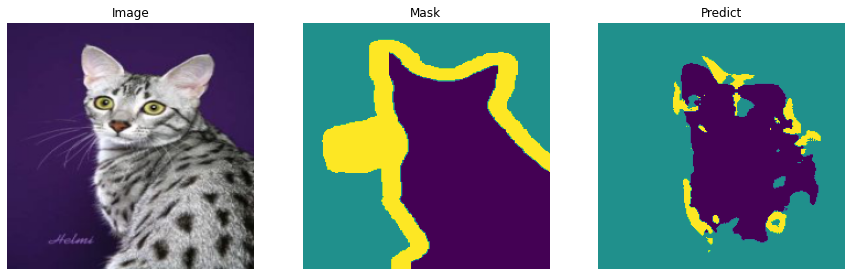

Current Step: 150 	Train Loss: 0.40422687232494353, Train Iou: 0.7975785732269287


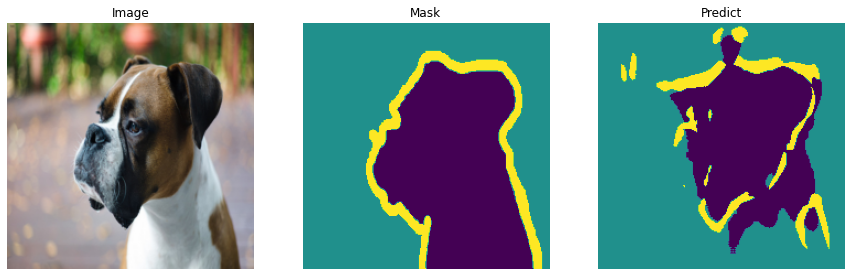

Current Step: 200 	Train Loss: 0.3806673014163971, Train Iou: 0.8089559674263


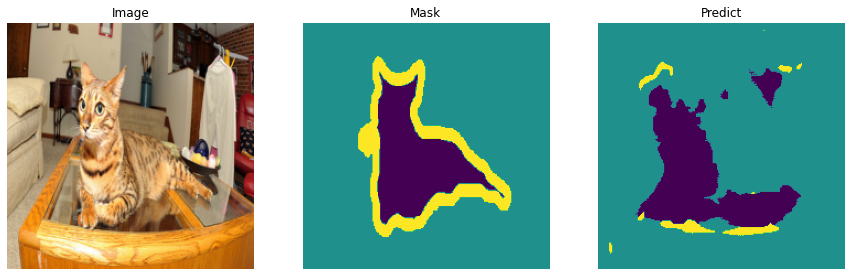

 Epoch: [3/30] - Validation
Validation step: Val Loss: 0.509564995765686, Val Iou: 0.783754289150238


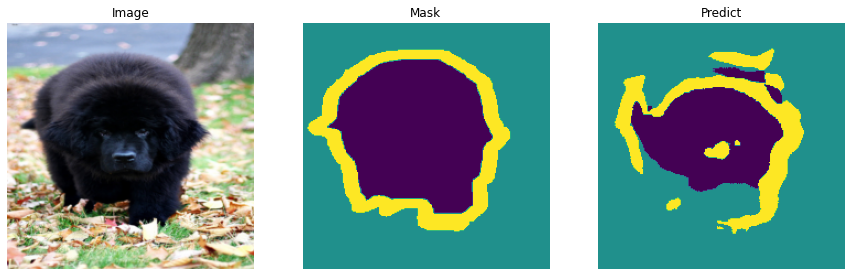

EarlyStopping counter: 1 out of 7
 Epoch: [4/30] - Train
Current Step: 50 	Train Loss: 0.37752717673778535, Train Iou: 0.8109572529792786


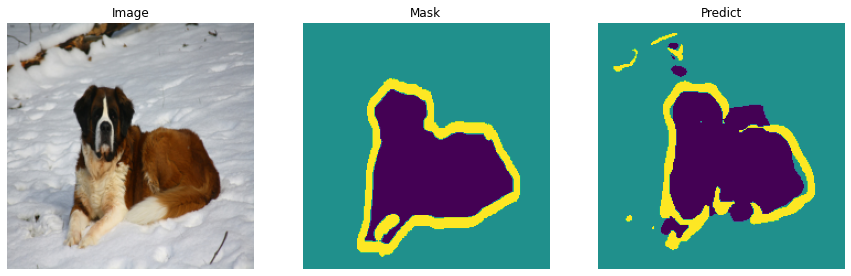

Current Step: 100 	Train Loss: 0.36423257648944857, Train Iou: 0.8175843954086304


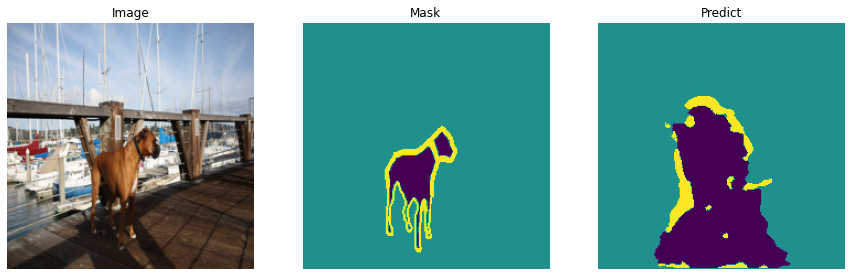

Current Step: 150 	Train Loss: 0.33335016429424286, Train Iou: 0.8273343443870544


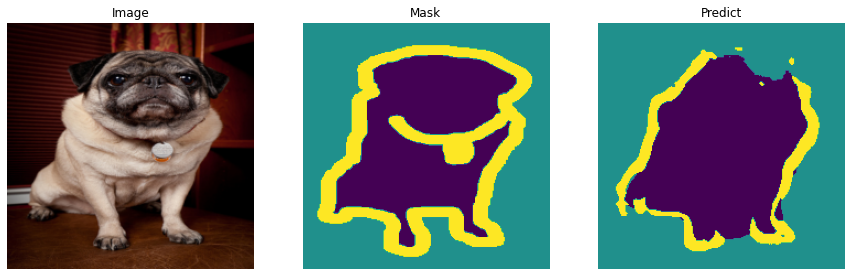

Current Step: 200 	Train Loss: 0.33297215700149535, Train Iou: 0.8273200392723083


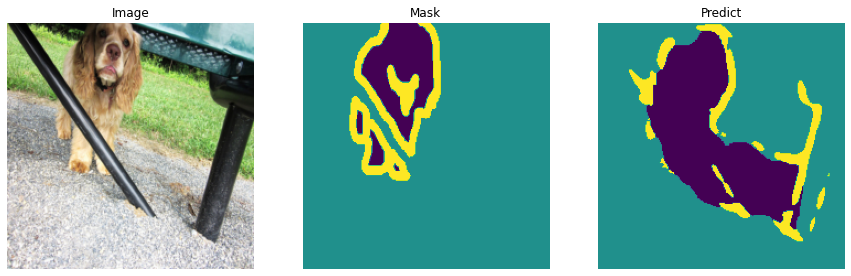

 Epoch: [4/30] - Validation
Validation step: Val Loss: 0.31996244192123413, Val Iou: 0.8429069519042969


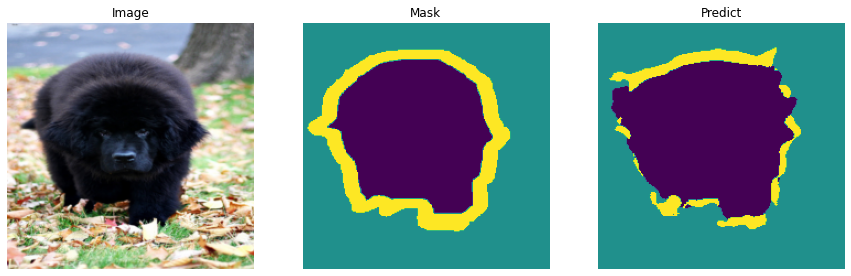

Validation loss decreased (0.461693 --> 0.319962).  Saving model ...
 Epoch: [5/30] - Train
Current Step: 50 	Train Loss: 0.32058828353881835, Train Iou: 0.8342185020446777


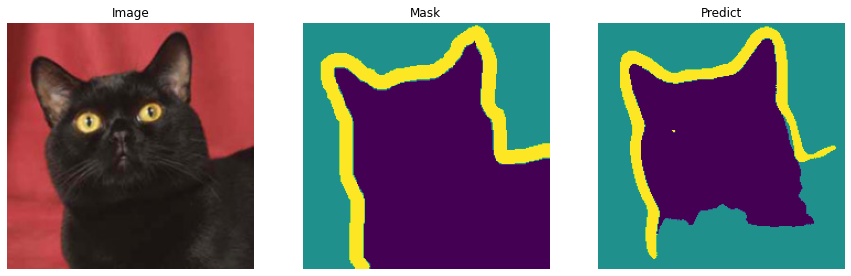

Current Step: 100 	Train Loss: 0.30949545443058013, Train Iou: 0.8403852581977844


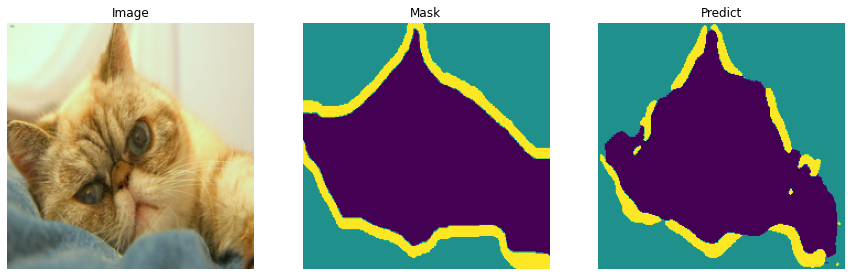

Current Step: 150 	Train Loss: 0.29918485701084135, Train Iou: 0.8451347947120667


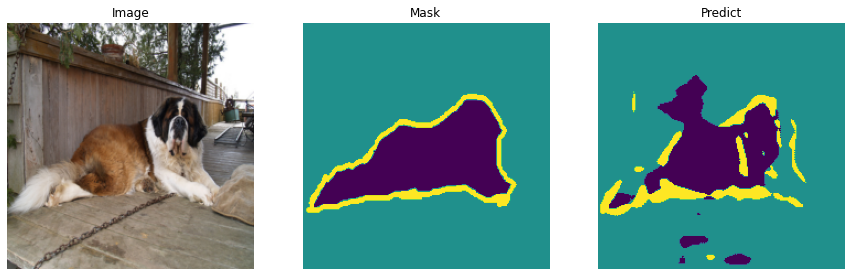

Current Step: 200 	Train Loss: 0.2860044986009598, Train Iou: 0.8491920232772827


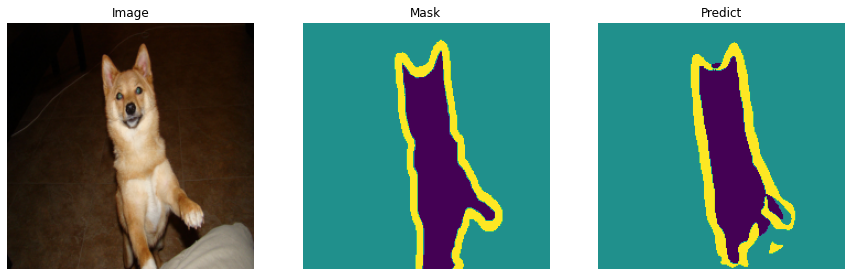

 Epoch: [5/30] - Validation
Validation step: Val Loss: 0.32475346326828003, Val Iou: 0.8171142339706421


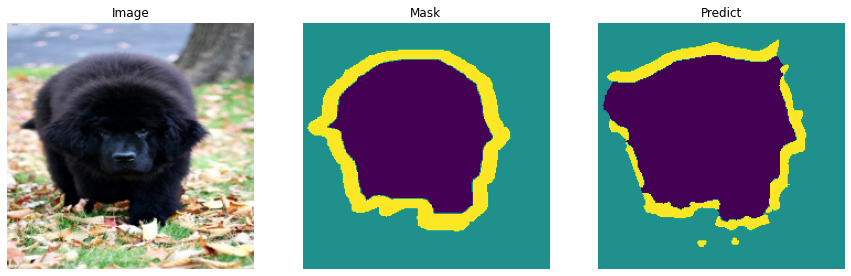

EarlyStopping counter: 1 out of 7
 Epoch: [6/30] - Train
Current Step: 50 	Train Loss: 0.2677358317375183, Train Iou: 0.8563570380210876


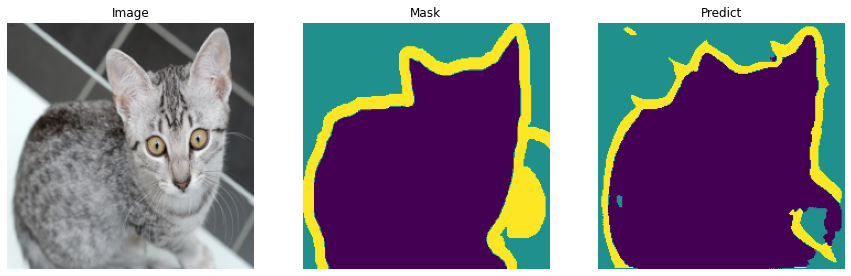

Current Step: 100 	Train Loss: 0.25902004539966583, Train Iou: 0.8587592840194702


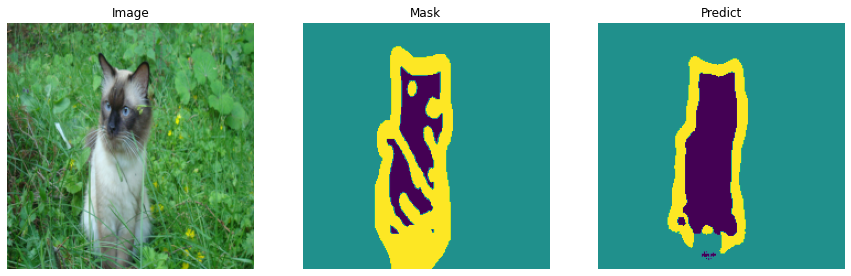

Current Step: 150 	Train Loss: 0.2721349275112152, Train Iou: 0.8559772968292236


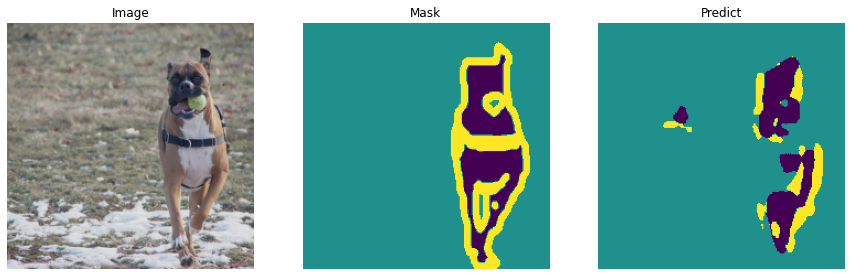

Current Step: 200 	Train Loss: 0.26508906722068787, Train Iou: 0.8605333566665649


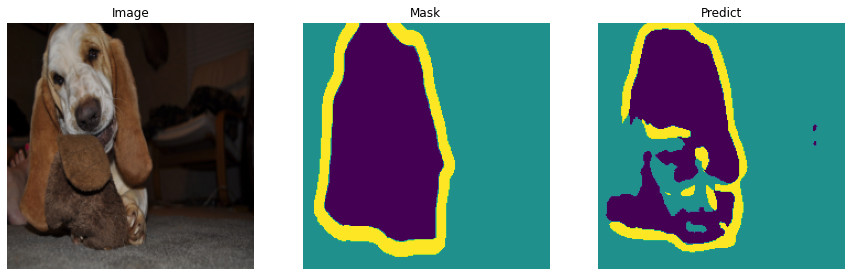

 Epoch: [6/30] - Validation
Validation step: Val Loss: 0.32975807785987854, Val Iou: 0.813213050365448


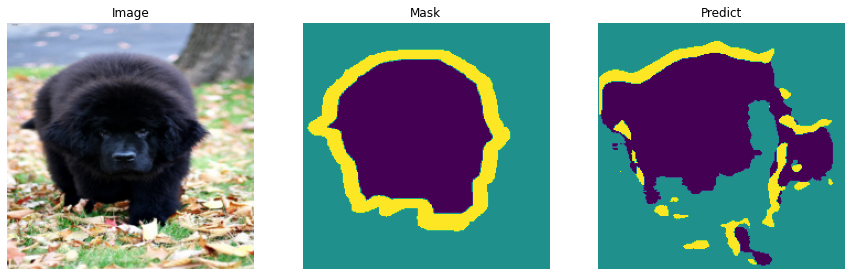

EarlyStopping counter: 2 out of 7
 Epoch: [7/30] - Train
Current Step: 50 	Train Loss: 0.2410463547706604, Train Iou: 0.8669118285179138


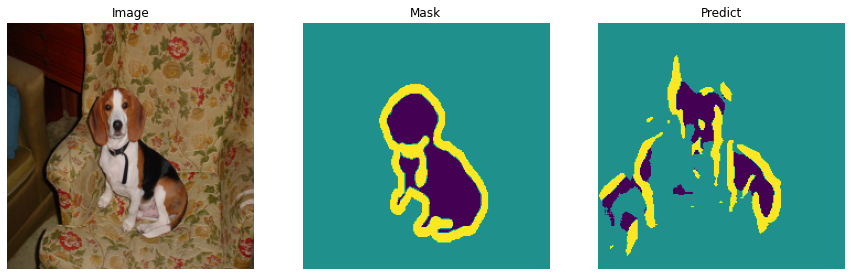

Current Step: 100 	Train Loss: 0.2457809317111969, Train Iou: 0.8657360672950745


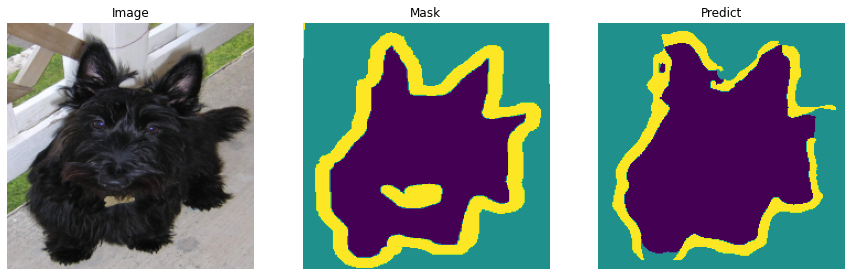

Current Step: 150 	Train Loss: 0.2526518499851227, Train Iou: 0.8658899664878845


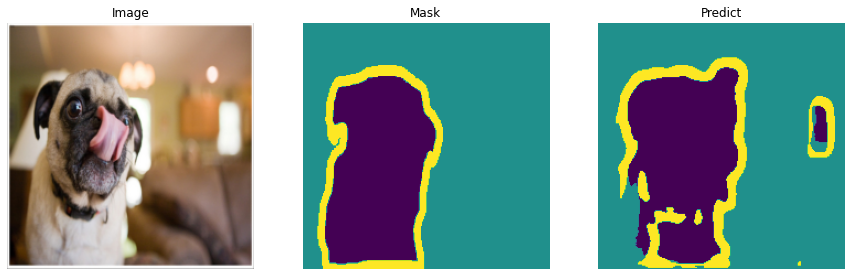

Current Step: 200 	Train Loss: 0.21558888435363768, Train Iou: 0.8782263398170471


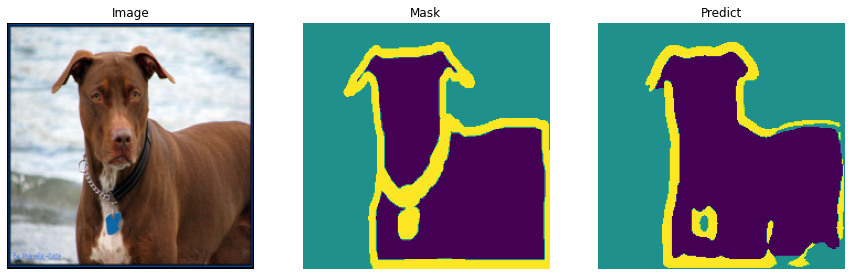

 Epoch: [7/30] - Validation
Validation step: Val Loss: 0.24617847800254822, Val Iou: 0.8744412660598755


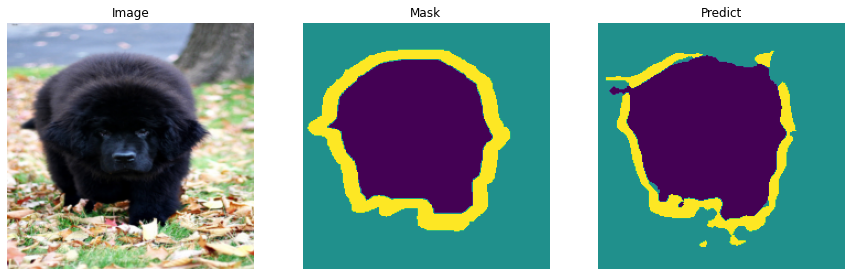

Validation loss decreased (0.319962 --> 0.246178).  Saving model ...
 Epoch: [8/30] - Train
Current Step: 50 	Train Loss: 0.20361649990081787, Train Iou: 0.8809847831726074


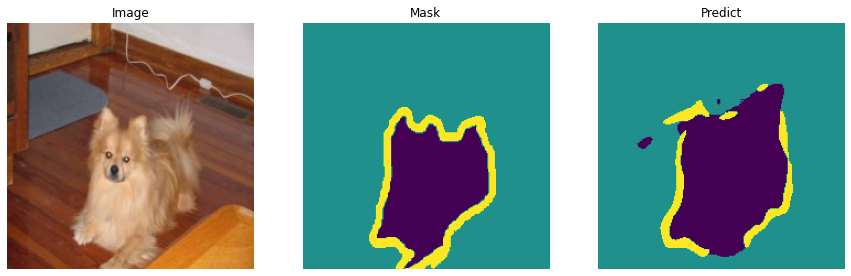

Current Step: 100 	Train Loss: 0.2023906284570694, Train Iou: 0.8851871490478516


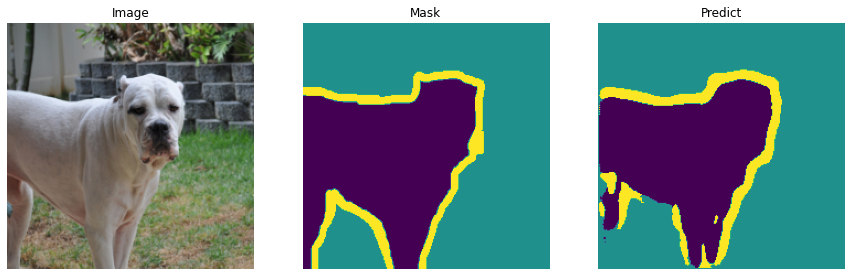

Current Step: 150 	Train Loss: 0.2251591318845749, Train Iou: 0.8785421848297119


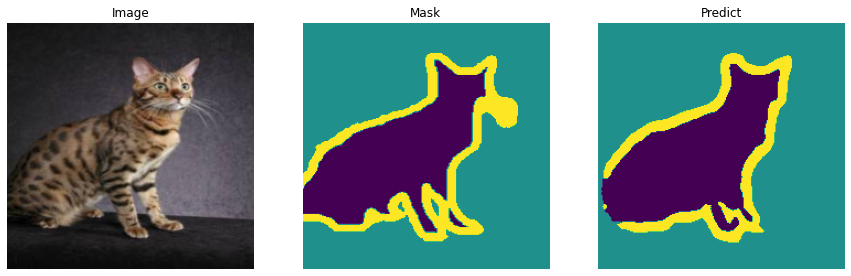

Current Step: 200 	Train Loss: 0.2135249888896942, Train Iou: 0.8803089261054993


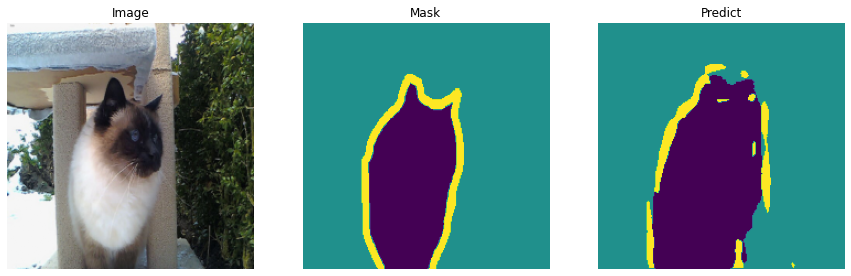

 Epoch: [8/30] - Validation
Validation step: Val Loss: 0.2162296175956726, Val Iou: 0.8837095499038696


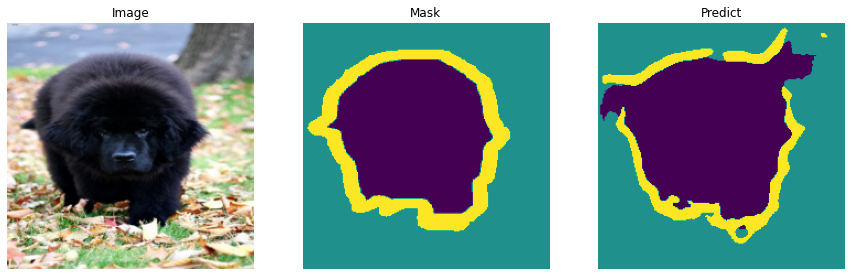

Validation loss decreased (0.246178 --> 0.216230).  Saving model ...
 Epoch: [9/30] - Train
Current Step: 50 	Train Loss: 0.1832750105857849, Train Iou: 0.8919238448143005


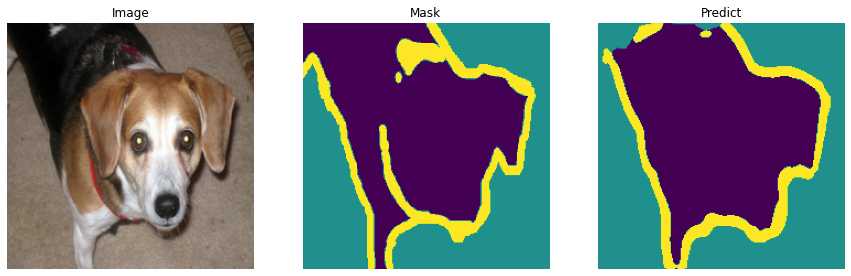

Current Step: 100 	Train Loss: 0.19924309015274047, Train Iou: 0.8869556188583374


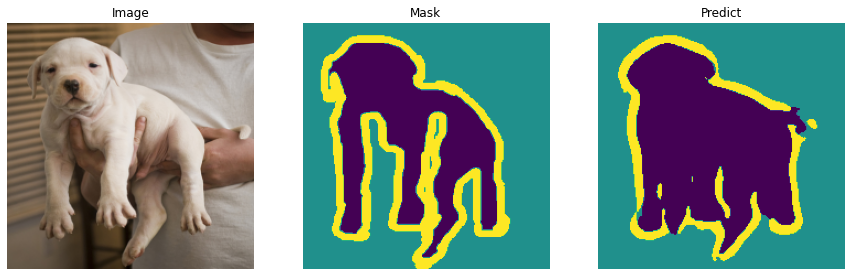

Current Step: 150 	Train Loss: 0.20444156289100646, Train Iou: 0.8842297196388245


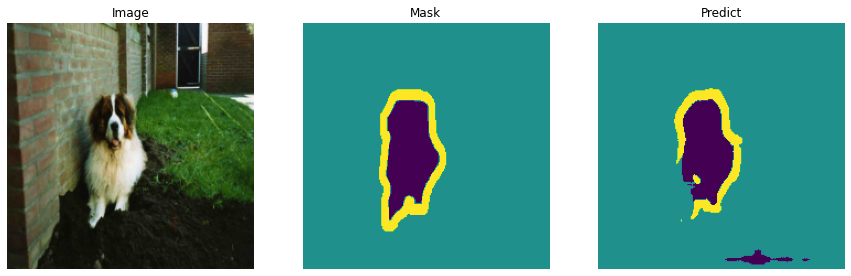

Current Step: 200 	Train Loss: 0.19717436611652375, Train Iou: 0.8880043625831604


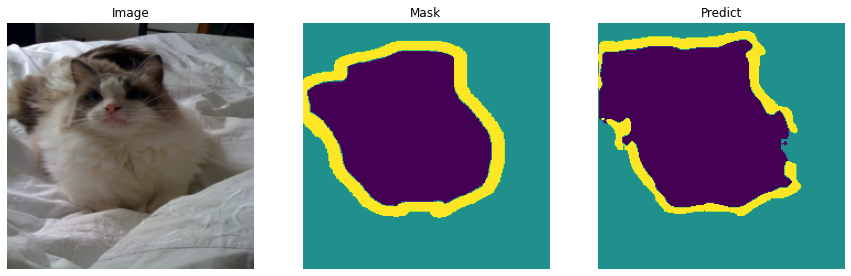

 Epoch: [9/30] - Validation
Validation step: Val Loss: 0.21493278443813324, Val Iou: 0.8682996034622192


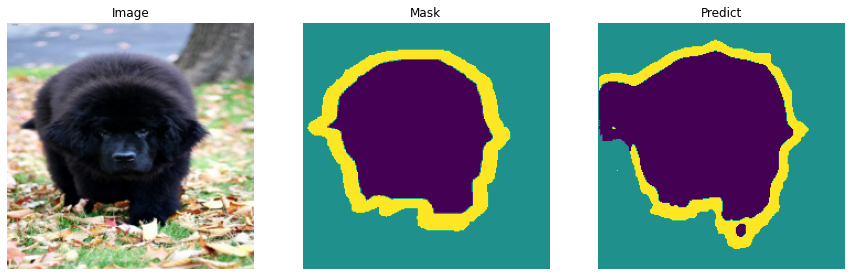

Validation loss decreased (0.216230 --> 0.214933).  Saving model ...
 Epoch: [10/30] - Train
Current Step: 50 	Train Loss: 0.177128586769104, Train Iou: 0.896058976650238


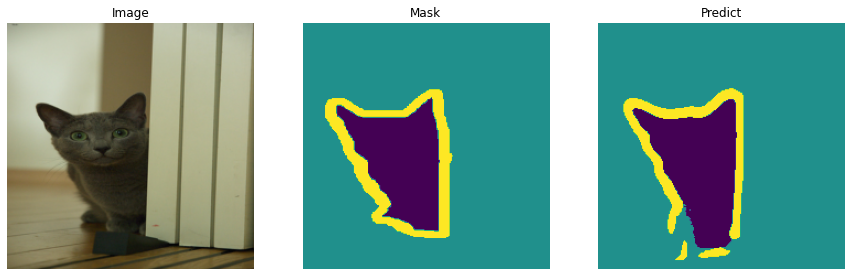

Current Step: 100 	Train Loss: 0.17515062868595124, Train Iou: 0.8966582417488098


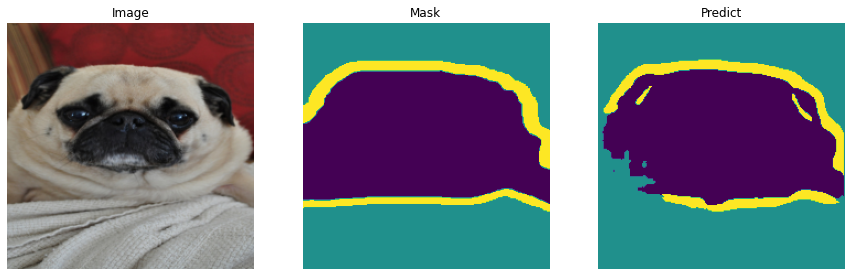

Current Step: 150 	Train Loss: 0.16948535710573195, Train Iou: 0.8992478847503662


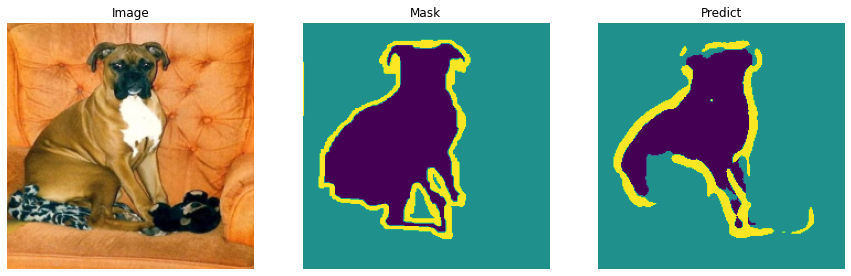

Current Step: 200 	Train Loss: 0.17888086557388305, Train Iou: 0.8959031701087952


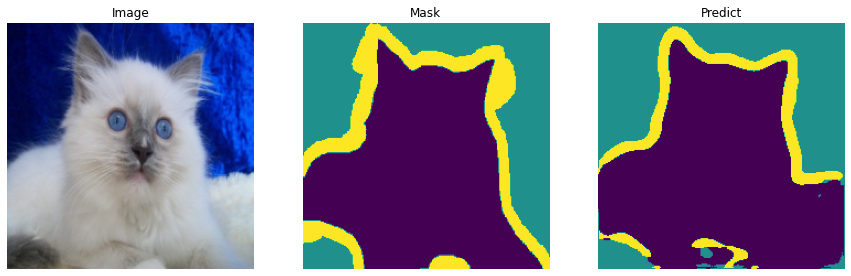

 Epoch: [10/30] - Validation
Validation step: Val Loss: 0.18600353598594666, Val Iou: 0.8937810659408569


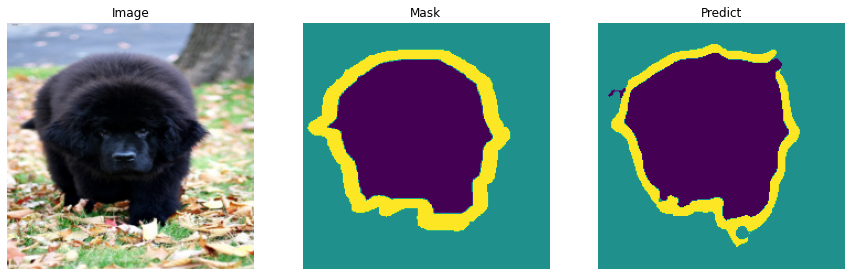

Validation loss decreased (0.214933 --> 0.186004).  Saving model ...
 Epoch: [11/30] - Train
Current Step: 50 	Train Loss: 0.17023327171802521, Train Iou: 0.8974525928497314


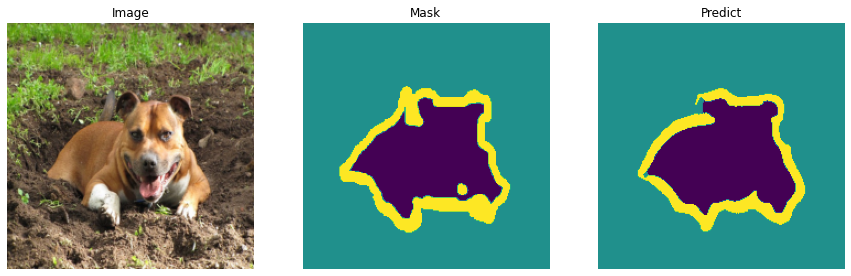

Current Step: 100 	Train Loss: 0.15040720939636232, Train Iou: 0.9055796265602112


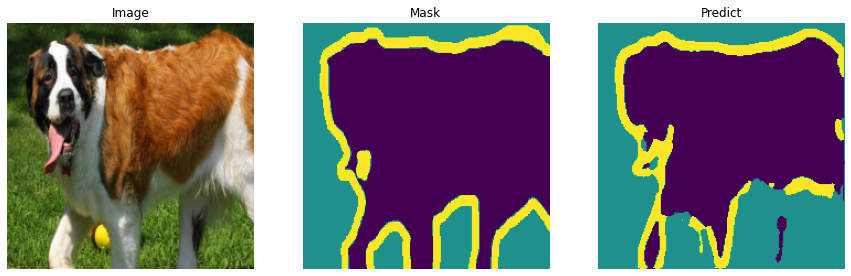

Current Step: 150 	Train Loss: 0.1545147803425789, Train Iou: 0.9054946899414062


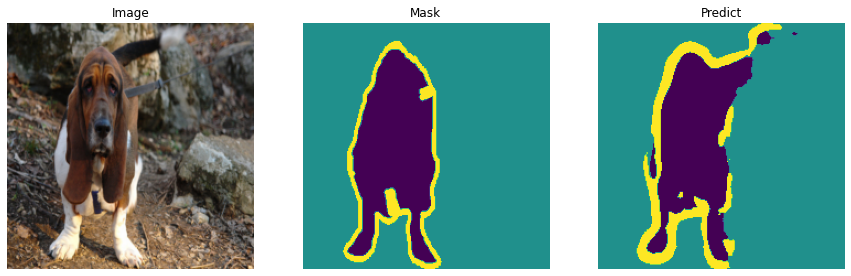

Current Step: 200 	Train Loss: 0.156299187541008, Train Iou: 0.9020211696624756


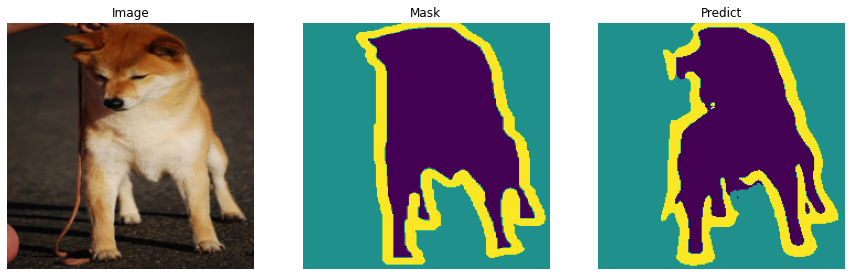

 Epoch: [11/30] - Validation
Validation step: Val Loss: 0.46562469005584717, Val Iou: 0.7395712733268738


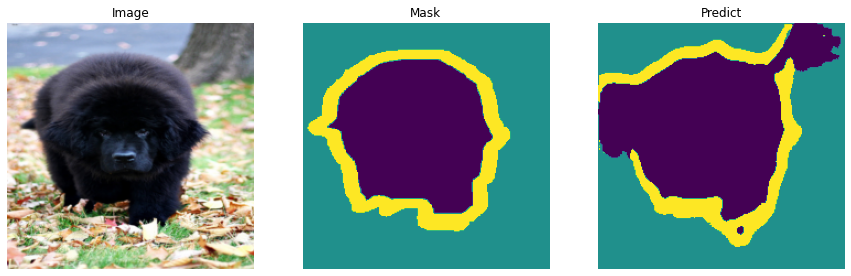

EarlyStopping counter: 1 out of 7
 Epoch: [12/30] - Train
Current Step: 50 	Train Loss: 0.14898566514253617, Train Iou: 0.9069908261299133


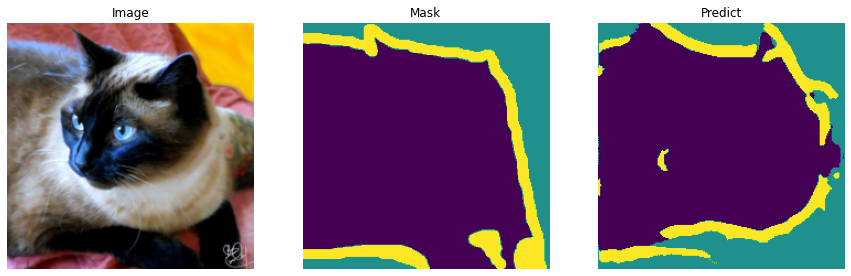

Current Step: 100 	Train Loss: 0.15605851501226425, Train Iou: 0.9048316478729248


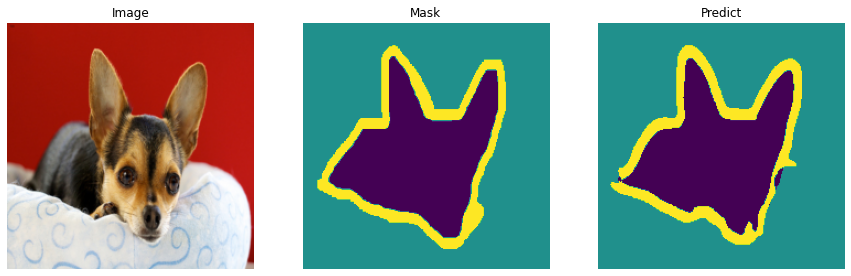

Current Step: 150 	Train Loss: 0.15940177232027053, Train Iou: 0.9023035168647766


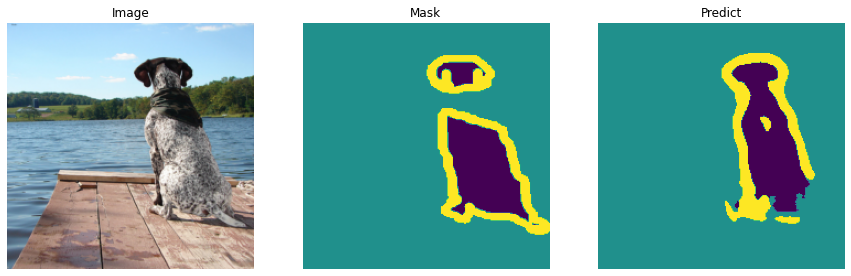

Current Step: 200 	Train Loss: 0.16002915680408478, Train Iou: 0.9042999148368835


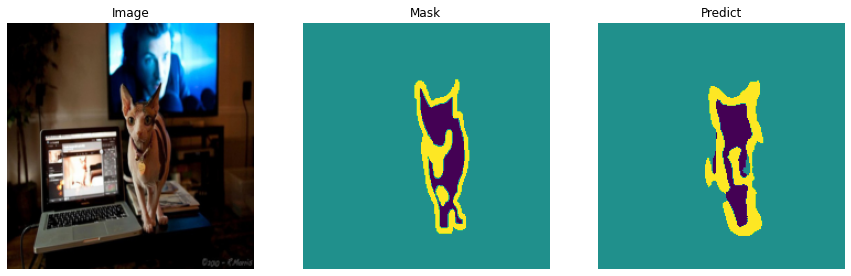

 Epoch: [12/30] - Validation
Validation step: Val Loss: 0.19024905562400818, Val Iou: 0.8915667533874512


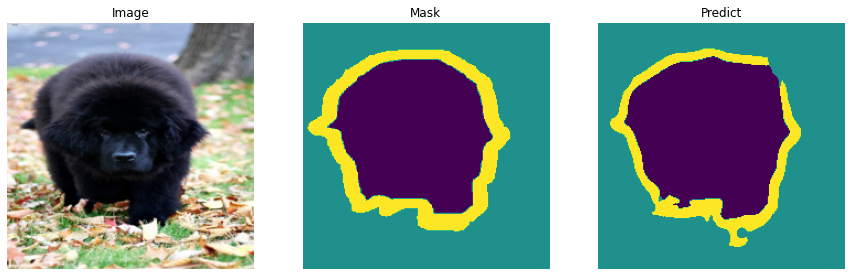

EarlyStopping counter: 2 out of 7
 Epoch: [13/30] - Train
Current Step: 50 	Train Loss: 0.12799302250146866, Train Iou: 0.9151412844657898


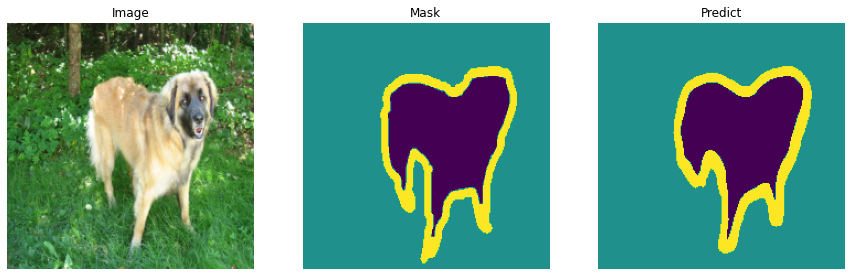

Current Step: 100 	Train Loss: 0.13419383734464646, Train Iou: 0.9131981134414673


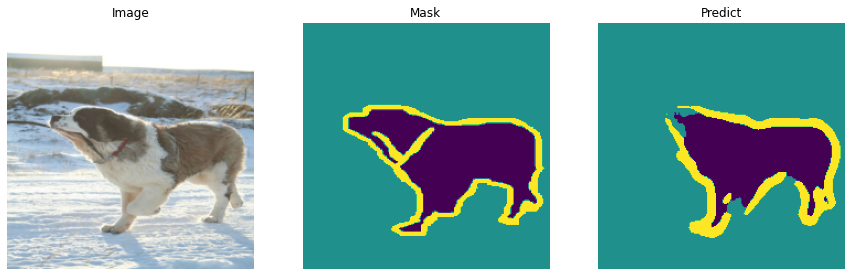

Current Step: 150 	Train Loss: 0.13556749612092972, Train Iou: 0.9128077030181885


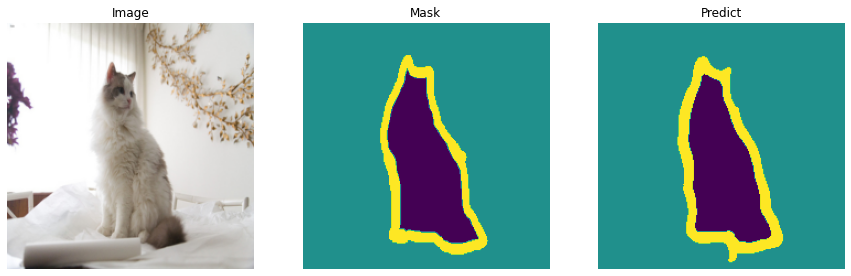

Current Step: 200 	Train Loss: 0.13886481046676635, Train Iou: 0.9113184213638306


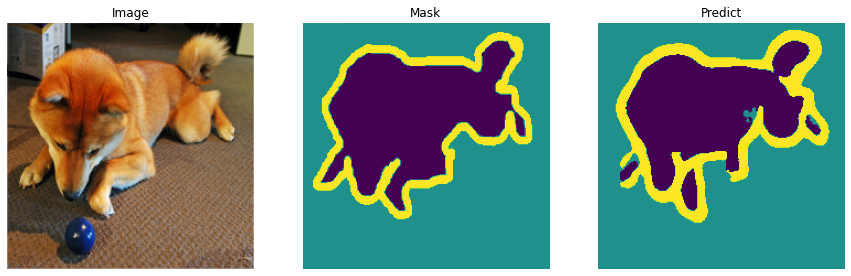

 Epoch: [13/30] - Validation
Validation step: Val Loss: 0.27050456404685974, Val Iou: 0.8358010649681091


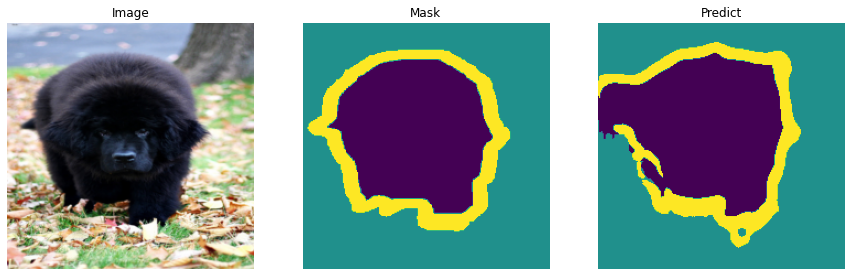

EarlyStopping counter: 3 out of 7
 Epoch: [14/30] - Train
Current Step: 50 	Train Loss: 0.131899134516716, Train Iou: 0.9141911268234253


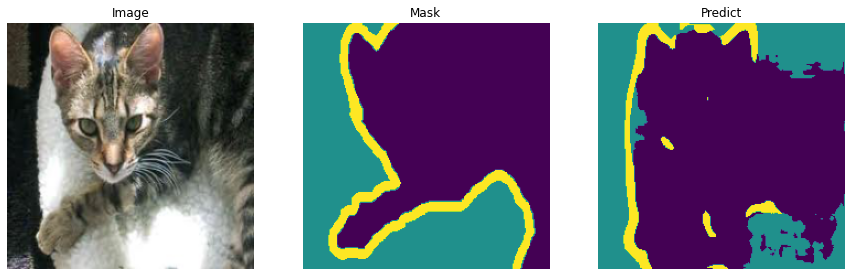

Current Step: 100 	Train Loss: 0.11270370572805405, Train Iou: 0.916308581829071


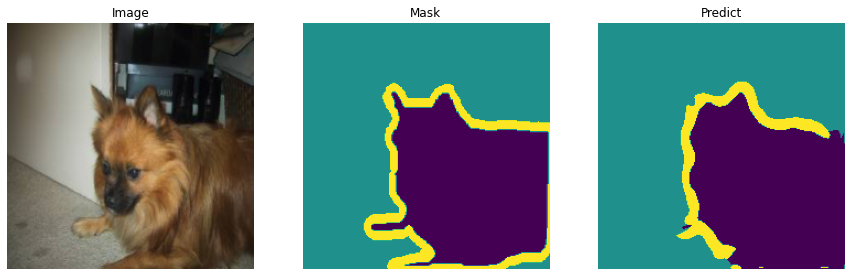

Current Step: 150 	Train Loss: 0.1325189557671547, Train Iou: 0.9150673747062683


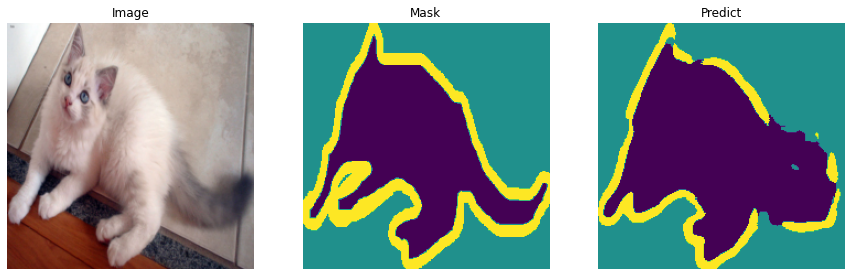

Current Step: 200 	Train Loss: 0.12938708901405335, Train Iou: 0.9173635244369507


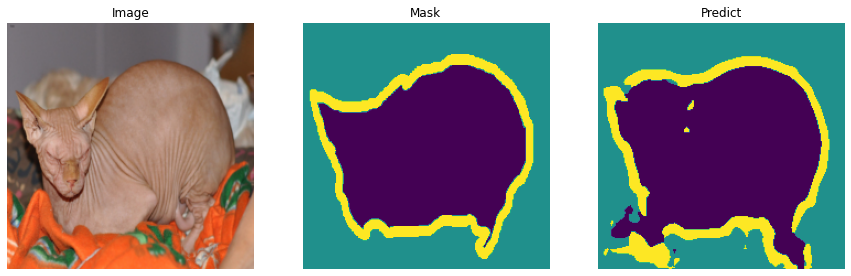

 Epoch: [14/30] - Validation
Validation step: Val Loss: 0.15086232125759125, Val Iou: 0.9023252725601196


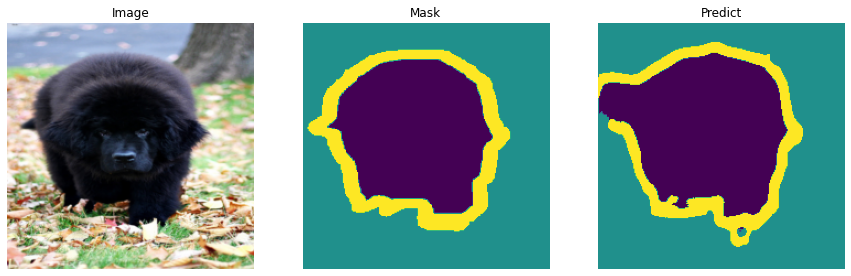

Validation loss decreased (0.186004 --> 0.150862).  Saving model ...
 Epoch: [15/30] - Train
Current Step: 50 	Train Loss: 0.10836210668087005, Train Iou: 0.9234232902526855


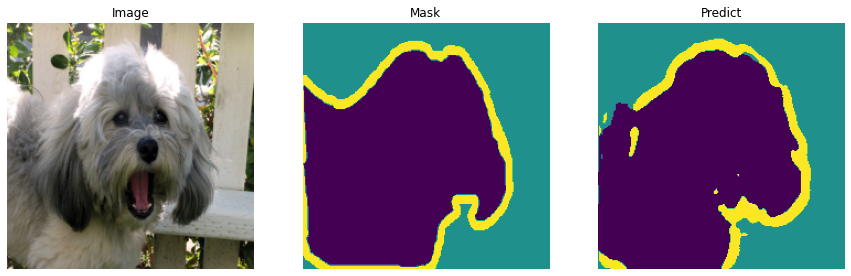

Current Step: 100 	Train Loss: 0.12244371354579925, Train Iou: 0.9183063507080078


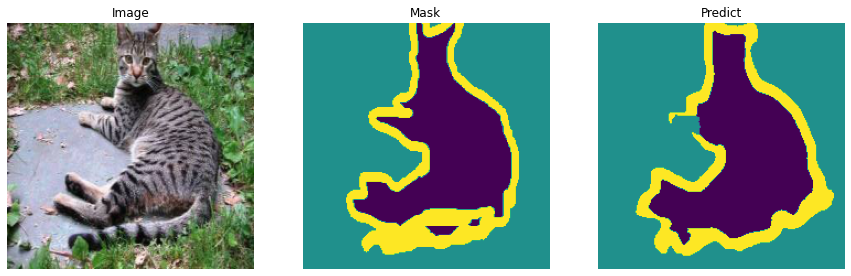

Current Step: 150 	Train Loss: 0.10417753398418426, Train Iou: 0.9233323931694031


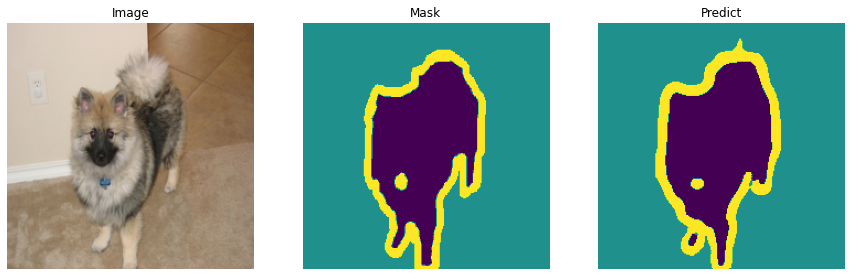

Current Step: 200 	Train Loss: 0.11504297256469727, Train Iou: 0.9212973117828369


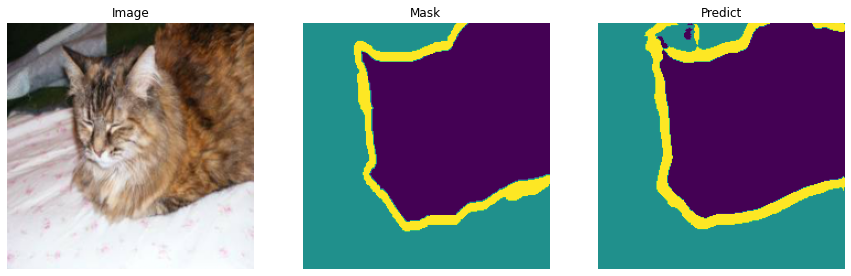

 Epoch: [15/30] - Validation
Validation step: Val Loss: 0.14494267106056213, Val Iou: 0.9050344228744507


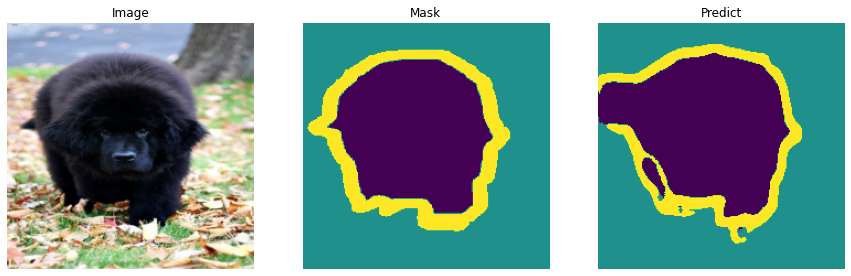

Validation loss decreased (0.150862 --> 0.144943).  Saving model ...
 Epoch: [16/30] - Train
Current Step: 50 	Train Loss: 0.09126488655805588, Train Iou: 0.9291425347328186


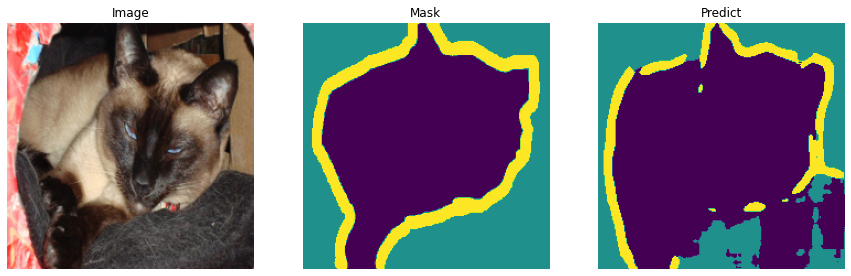

Current Step: 100 	Train Loss: 0.11327487349510193, Train Iou: 0.9227850437164307


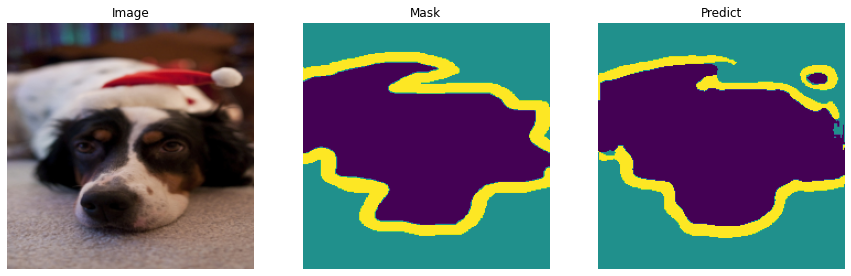

Current Step: 150 	Train Loss: 0.09843213379383087, Train Iou: 0.9265807867050171


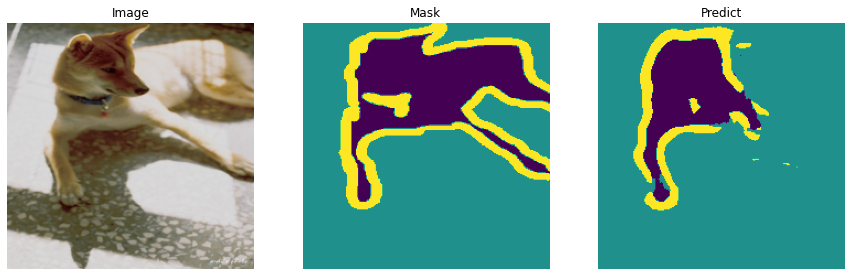

Current Step: 200 	Train Loss: 0.09160624265670776, Train Iou: 0.9285505414009094


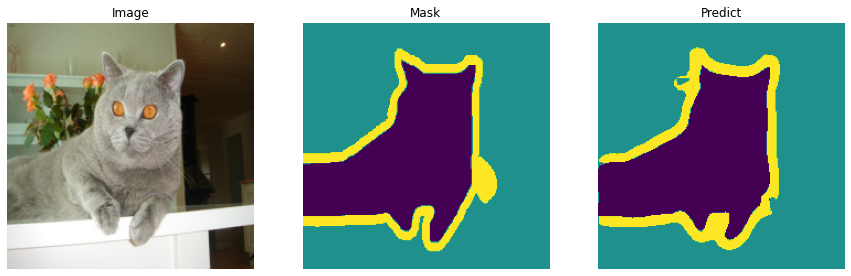

 Epoch: [16/30] - Validation
Validation step: Val Loss: 0.1344817578792572, Val Iou: 0.9124534130096436


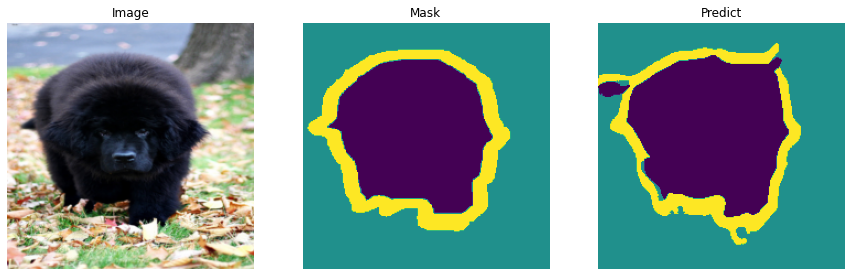

Validation loss decreased (0.144943 --> 0.134482).  Saving model ...
 Epoch: [17/30] - Train
Current Step: 50 	Train Loss: 0.07730756938457489, Train Iou: 0.9339327216148376


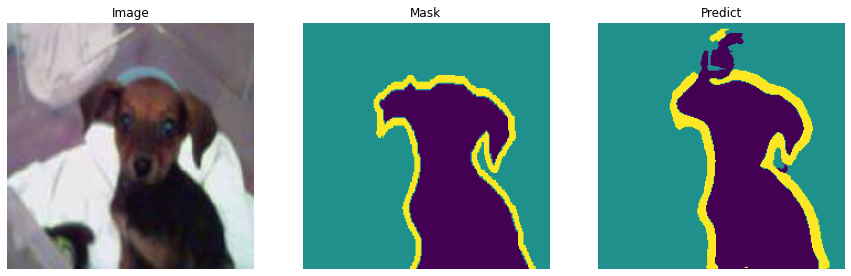

Current Step: 100 	Train Loss: 0.09982470840215683, Train Iou: 0.9286218881607056


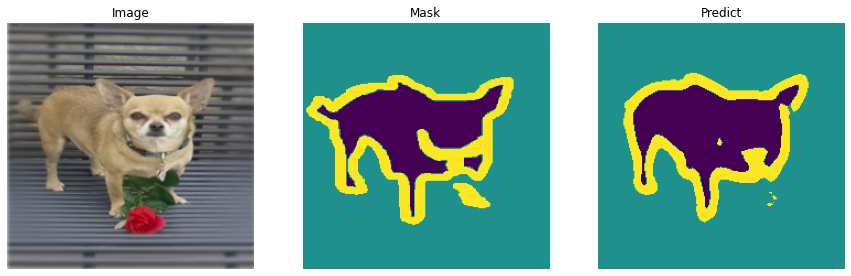

Current Step: 150 	Train Loss: 0.0978940486907959, Train Iou: 0.9282815456390381


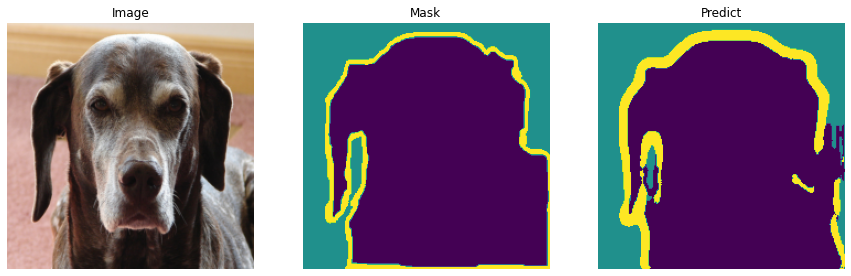

Current Step: 200 	Train Loss: 0.08415471404790878, Train Iou: 0.9311023950576782


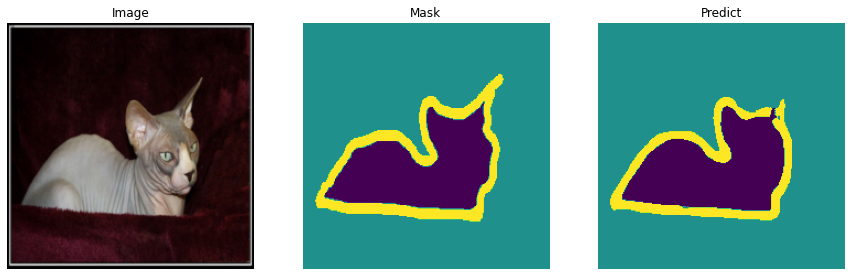

 Epoch: [17/30] - Validation
Validation step: Val Loss: 0.13938866555690765, Val Iou: 0.9131001234054565


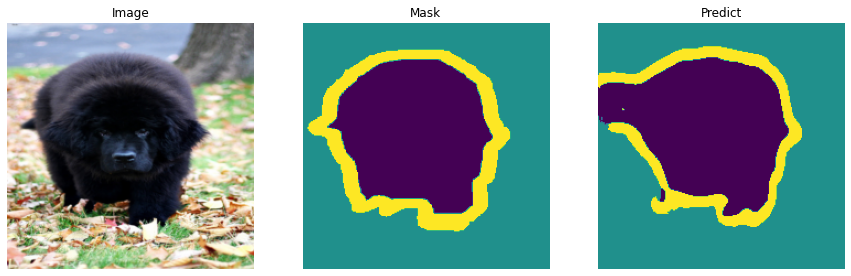

EarlyStopping counter: 1 out of 7
 Epoch: [18/30] - Train
Current Step: 50 	Train Loss: 0.0824504977464676, Train Iou: 0.9334259629249573


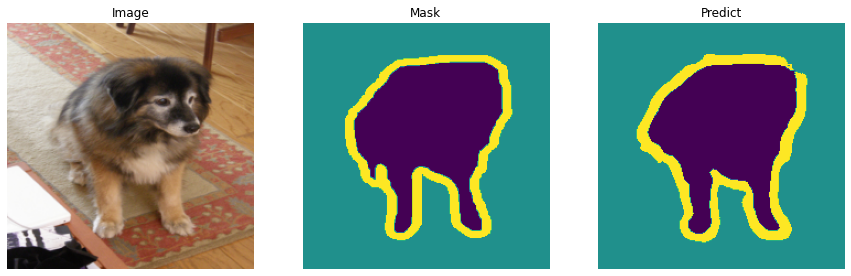

Current Step: 100 	Train Loss: 0.07522924602031708, Train Iou: 0.9339070320129395


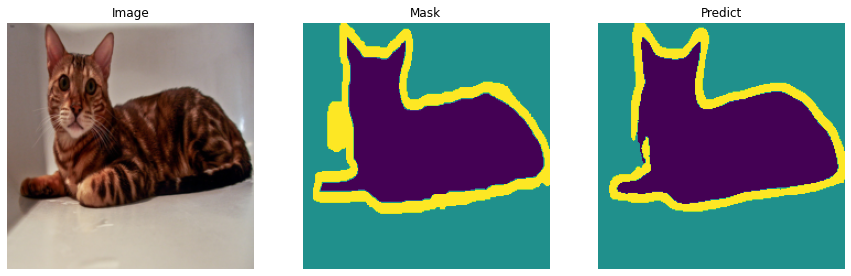

Current Step: 150 	Train Loss: 0.08300226777791977, Train Iou: 0.934937059879303


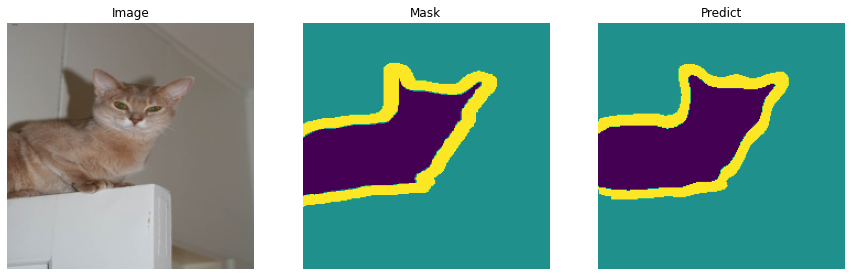

Current Step: 200 	Train Loss: 0.07172117233276368, Train Iou: 0.9360870122909546


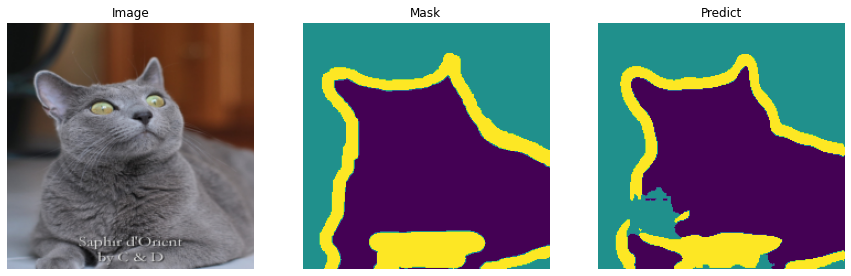

 Epoch: [18/30] - Validation
Validation step: Val Loss: 0.1533435583114624, Val Iou: 0.8982370495796204


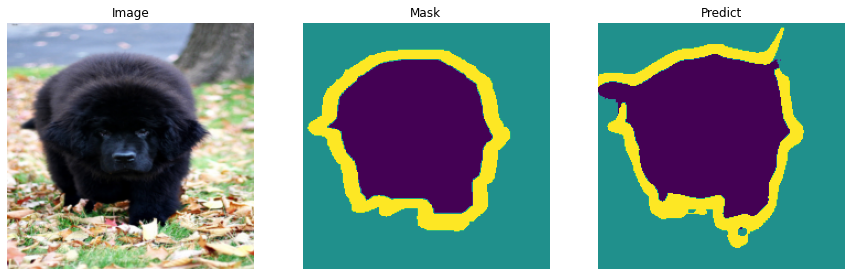

EarlyStopping counter: 2 out of 7
 Epoch: [19/30] - Train
Current Step: 50 	Train Loss: 0.06739677131175995, Train Iou: 0.938870370388031


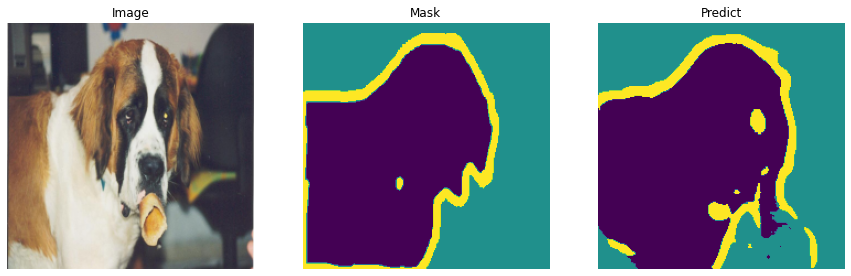

Current Step: 100 	Train Loss: 0.06283476084470749, Train Iou: 0.9412286877632141


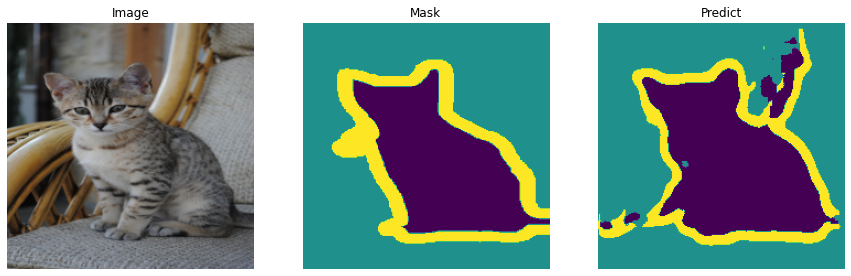

Current Step: 150 	Train Loss: 0.0709085276722908, Train Iou: 0.9356085062026978


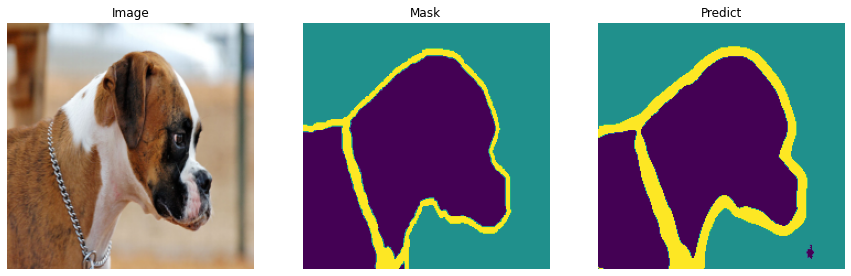

Current Step: 200 	Train Loss: 0.08263650238513946, Train Iou: 0.9326829314231873


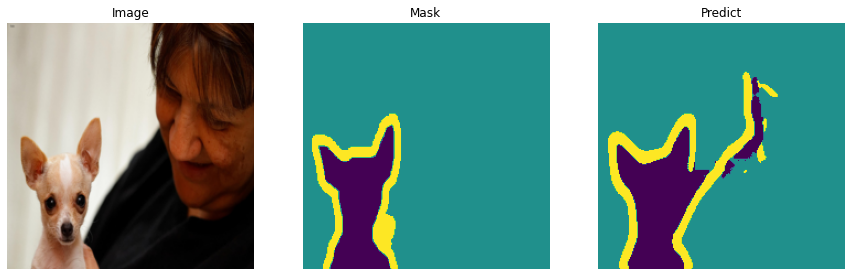

 Epoch: [19/30] - Validation
Validation step: Val Loss: 0.12696880102157593, Val Iou: 0.9152473211288452


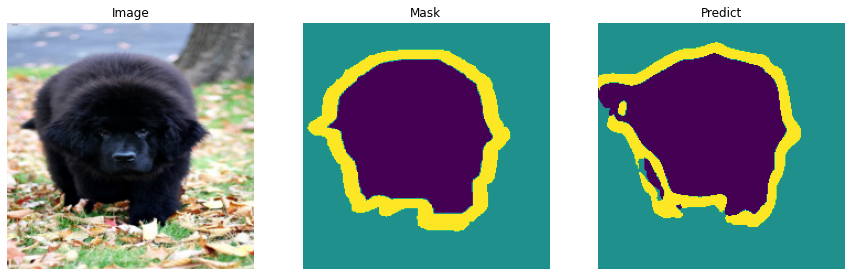

Validation loss decreased (0.134482 --> 0.126969).  Saving model ...
 Epoch: [20/30] - Train
Current Step: 50 	Train Loss: 0.04334399312734604, Train Iou: 0.9449884295463562


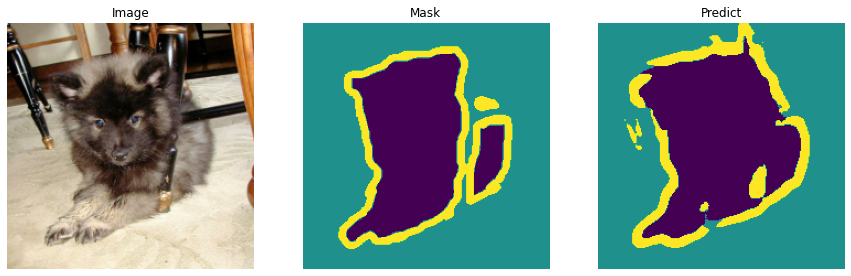

Current Step: 100 	Train Loss: 0.062062662243843075, Train Iou: 0.9429488182067871


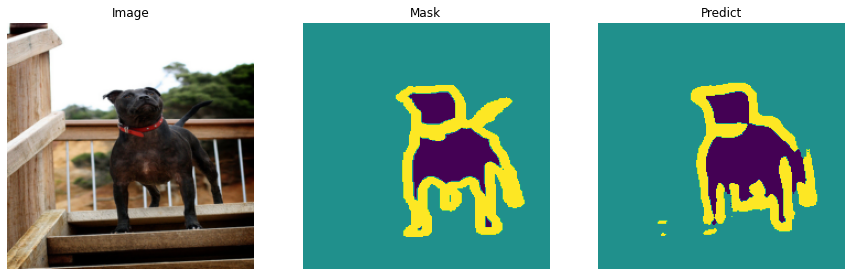

Current Step: 150 	Train Loss: 0.06267561554908753, Train Iou: 0.9420343637466431


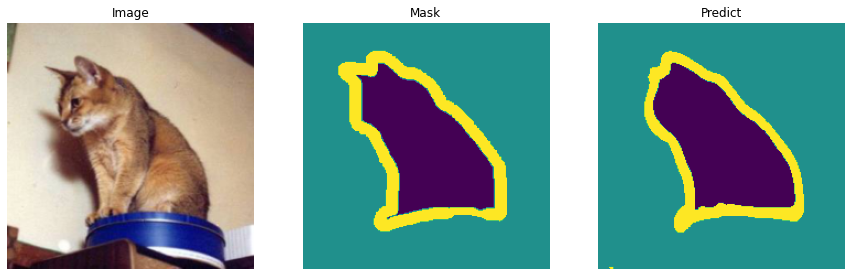

Current Step: 200 	Train Loss: 0.06914227455854416, Train Iou: 0.9398346543312073


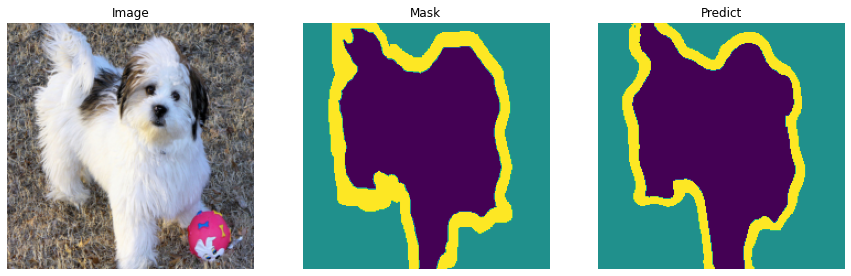

 Epoch: [20/30] - Validation
Validation step: Val Loss: 0.13241088390350342, Val Iou: 0.9157007336616516


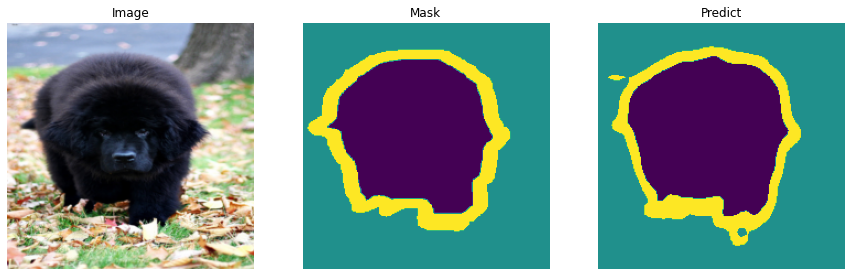

EarlyStopping counter: 1 out of 7
 Epoch: [21/30] - Train
Current Step: 50 	Train Loss: 0.057142163515090945, Train Iou: 0.9426078796386719


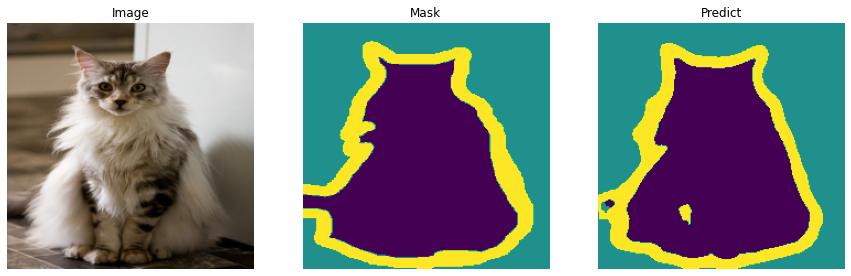

Current Step: 100 	Train Loss: 0.04375261694192886, Train Iou: 0.9440200328826904


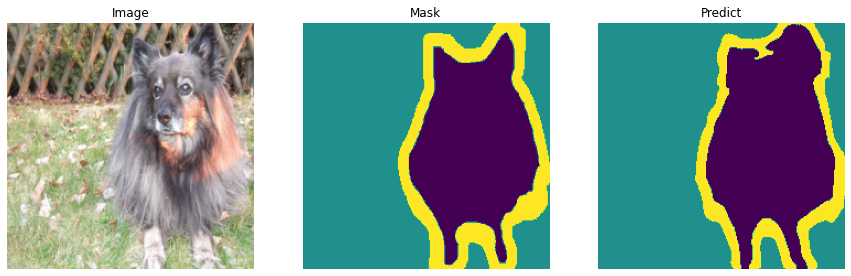

Current Step: 150 	Train Loss: 0.06102197766304016, Train Iou: 0.9417803883552551


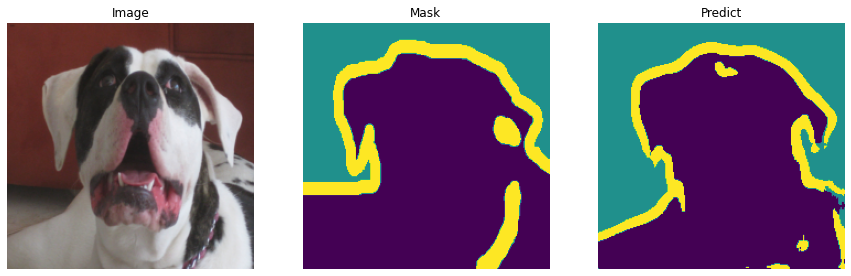

Current Step: 200 	Train Loss: 0.0649621069431305, Train Iou: 0.9415931105613708


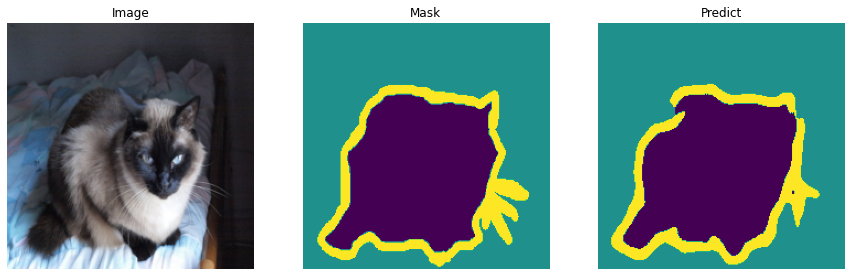

 Epoch: [21/30] - Validation
Validation step: Val Loss: 0.12389374524354935, Val Iou: 0.9211845397949219


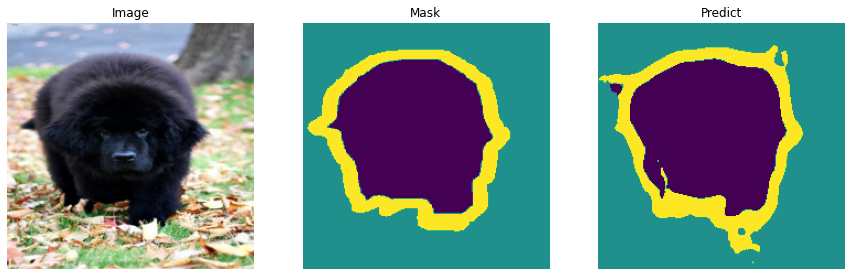

Validation loss decreased (0.126969 --> 0.123894).  Saving model ...
 Epoch: [22/30] - Train
Current Step: 50 	Train Loss: 0.04600376486778259, Train Iou: 0.9463368058204651


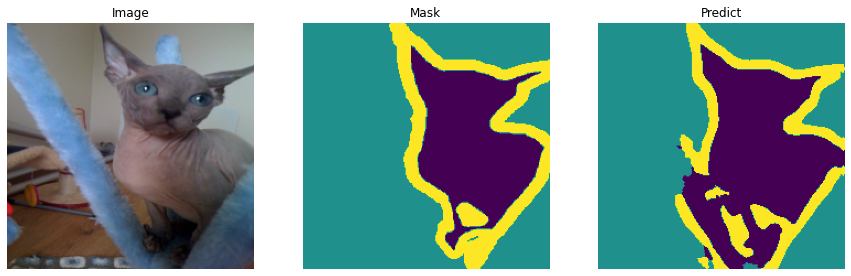

Current Step: 100 	Train Loss: 0.03952607423067093, Train Iou: 0.9466539621353149


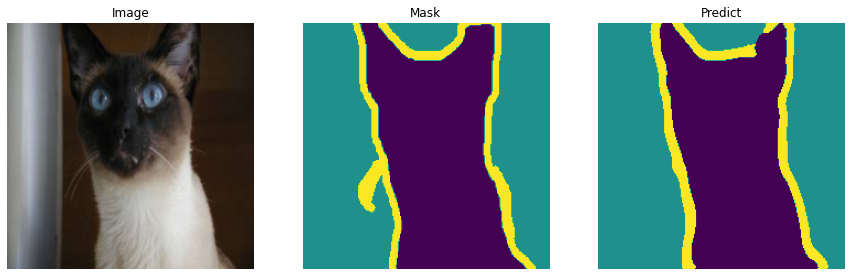

Current Step: 150 	Train Loss: 0.0574286413192749, Train Iou: 0.9425204396247864


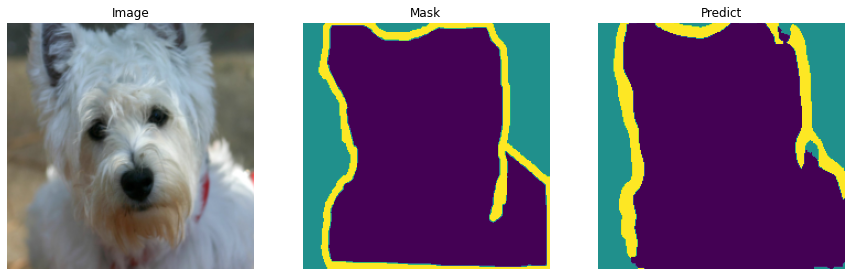

Current Step: 200 	Train Loss: 0.05995750159025192, Train Iou: 0.9437167644500732


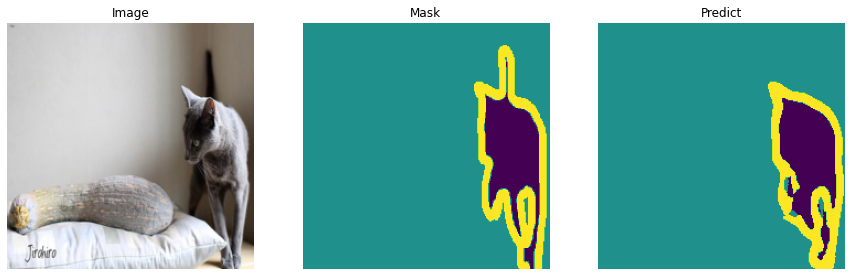

 Epoch: [22/30] - Validation
Validation step: Val Loss: 0.1304202526807785, Val Iou: 0.9189136028289795


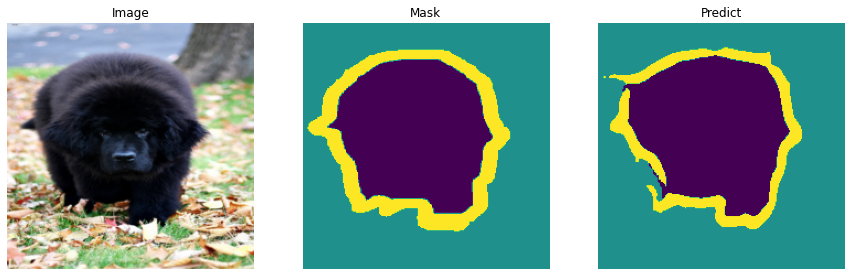

EarlyStopping counter: 1 out of 7
 Epoch: [23/30] - Train
Current Step: 50 	Train Loss: 0.04960389018058777, Train Iou: 0.94597327709198


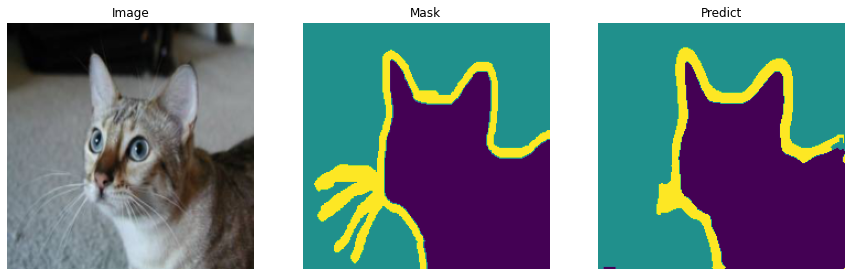

Current Step: 100 	Train Loss: 0.04308295965194702, Train Iou: 0.9486460089683533


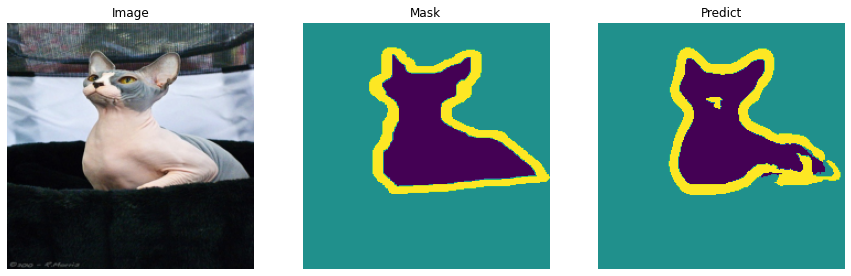

Current Step: 150 	Train Loss: 0.03125105559825897, Train Iou: 0.9514787793159485


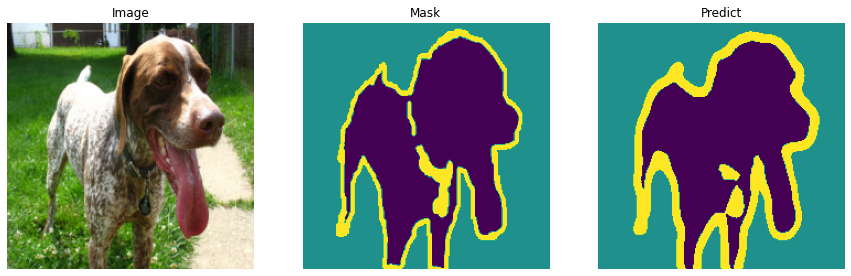

Current Step: 200 	Train Loss: 0.03167266190052032, Train Iou: 0.9509996771812439


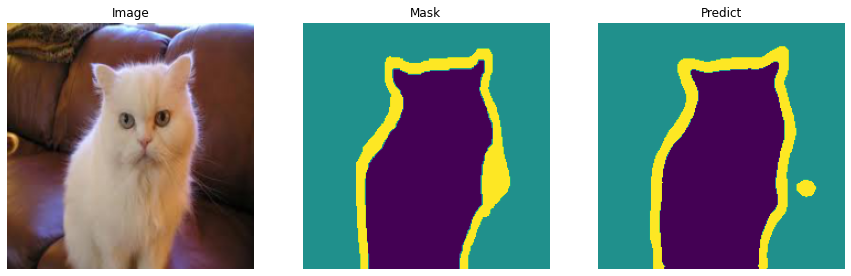

 Epoch: [23/30] - Validation
Validation step: Val Loss: 0.12875480949878693, Val Iou: 0.9241215586662292


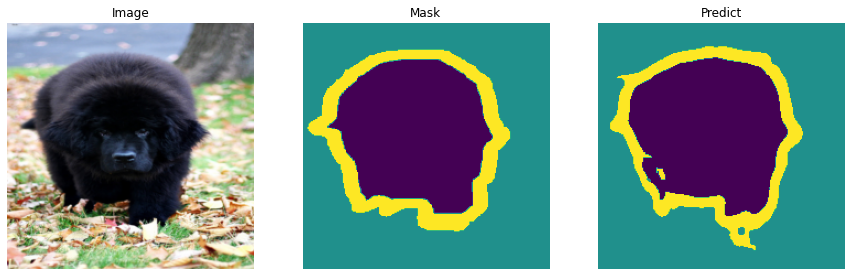

EarlyStopping counter: 2 out of 7
 Epoch: [24/30] - Train
Current Step: 50 	Train Loss: 0.02015224188566208, Train Iou: 0.9543715119361877


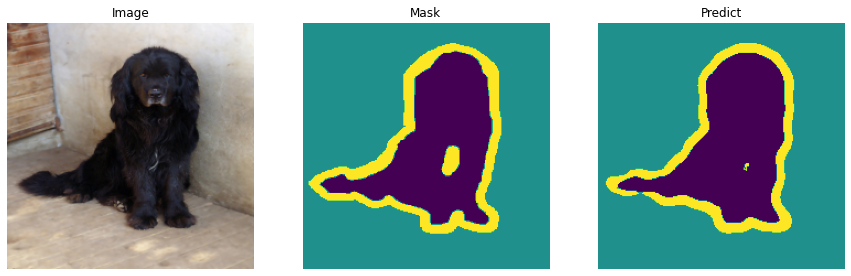

Current Step: 100 	Train Loss: 0.034476270377635954, Train Iou: 0.9539705514907837


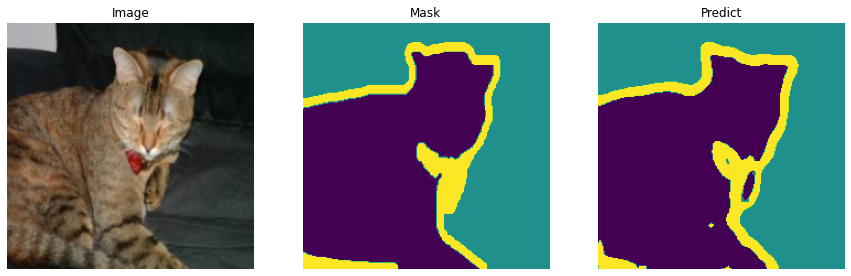

Current Step: 150 	Train Loss: 0.01866558849811554, Train Iou: 0.9526754021644592


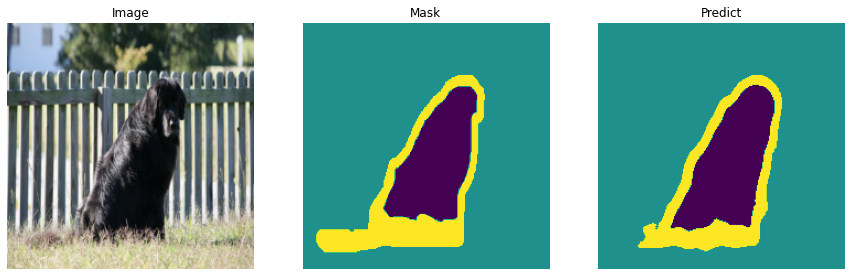

Current Step: 200 	Train Loss: 0.033708373308181765, Train Iou: 0.9524638652801514


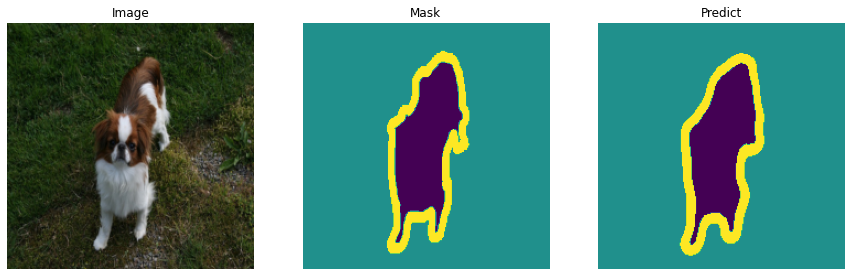

 Epoch: [24/30] - Validation
Validation step: Val Loss: 0.13065585494041443, Val Iou: 0.9221213459968567


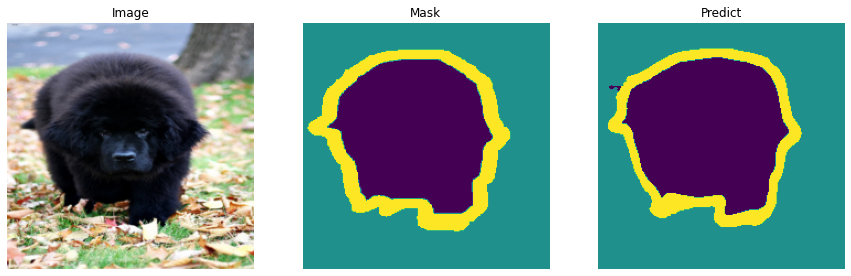

EarlyStopping counter: 3 out of 7
 Epoch: [25/30] - Train
Current Step: 50 	Train Loss: 0.019124096930027007, Train Iou: 0.9556791186332703


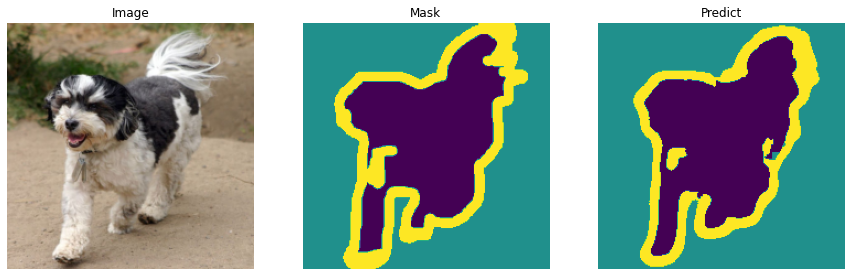

Current Step: 100 	Train Loss: 0.026826595067977906, Train Iou: 0.9533188343048096


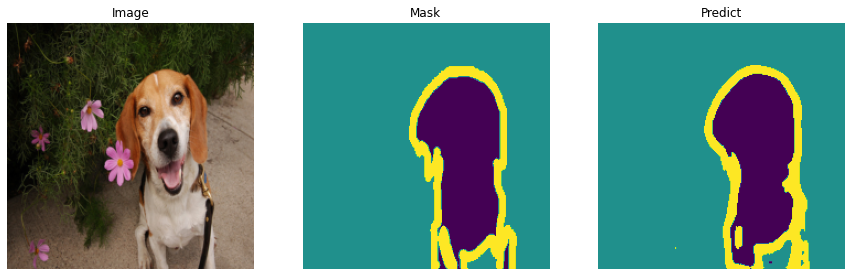

Current Step: 150 	Train Loss: 0.015958093106746674, Train Iou: 0.9542449712753296


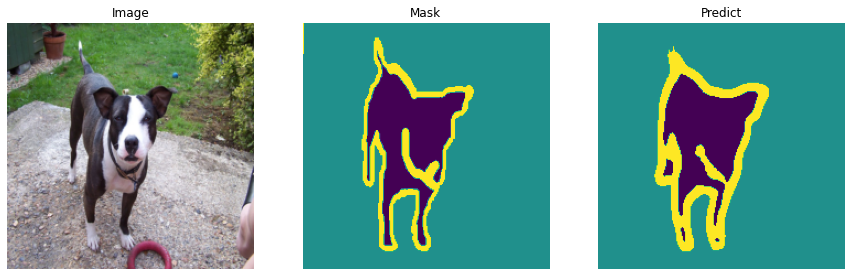

Current Step: 200 	Train Loss: 0.03463637471199035, Train Iou: 0.9533146619796753


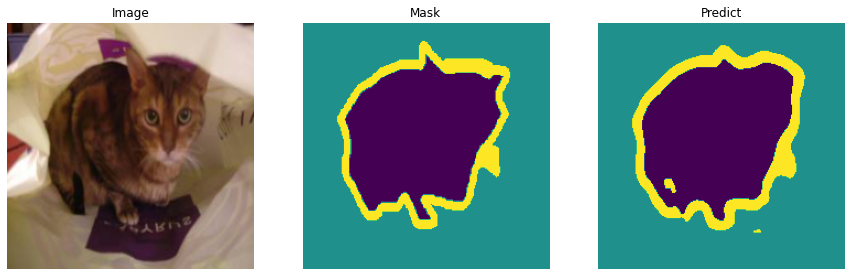

 Epoch: [25/30] - Validation
Validation step: Val Loss: 0.17545464634895325, Val Iou: 0.9066261649131775


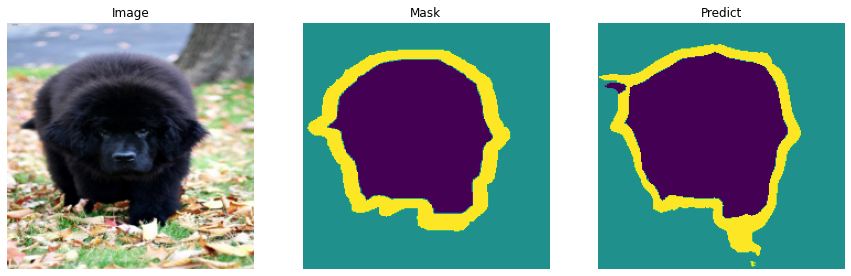

EarlyStopping counter: 4 out of 7
 Epoch: [26/30] - Train
Current Step: 50 	Train Loss: 0.020765943825244902, Train Iou: 0.9557197690010071


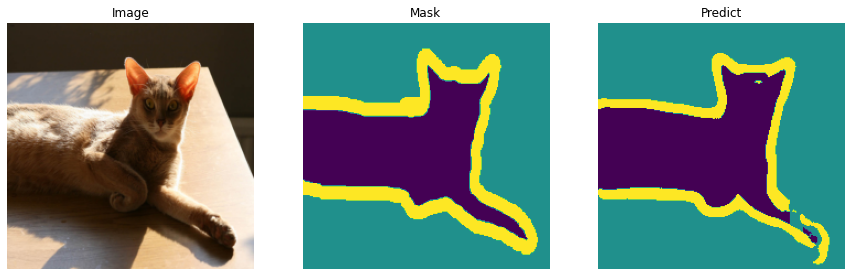

Current Step: 100 	Train Loss: 0.015568072199821472, Train Iou: 0.9568846821784973


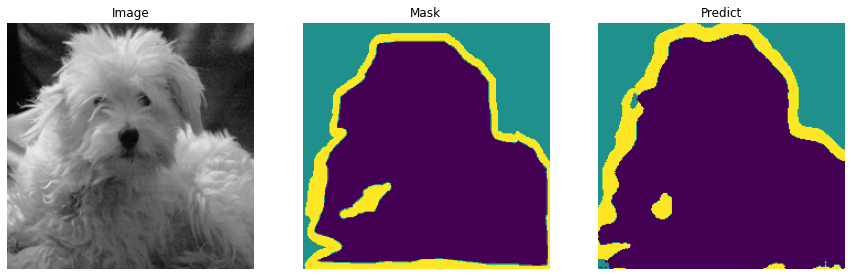

Current Step: 150 	Train Loss: 0.014275228083133697, Train Iou: 0.956979513168335


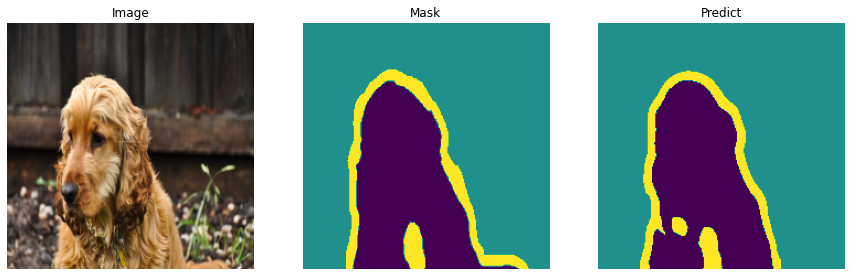

Current Step: 200 	Train Loss: 0.012398476898670196, Train Iou: 0.957644522190094


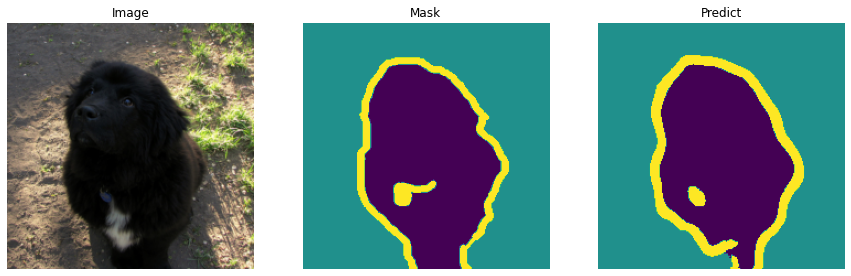

 Epoch: [26/30] - Validation
Validation step: Val Loss: 0.13872718811035156, Val Iou: 0.9221774935722351


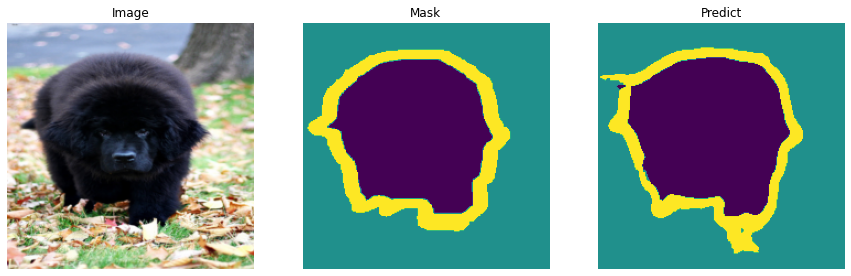

EarlyStopping counter: 5 out of 7
 Epoch: [27/30] - Train
Current Step: 50 	Train Loss: 0.01365599125623703, Train Iou: 0.9576169848442078


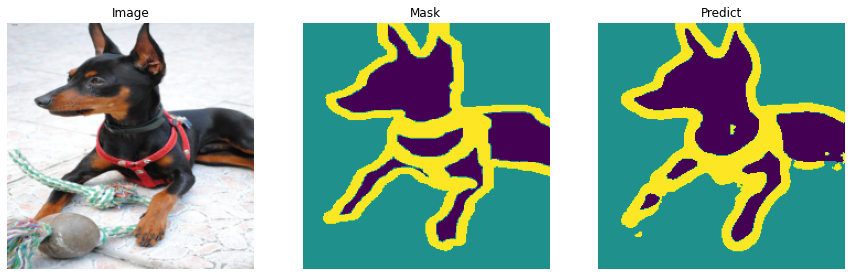

Current Step: 100 	Train Loss: 0.004735054671764374, Train Iou: 0.958967924118042


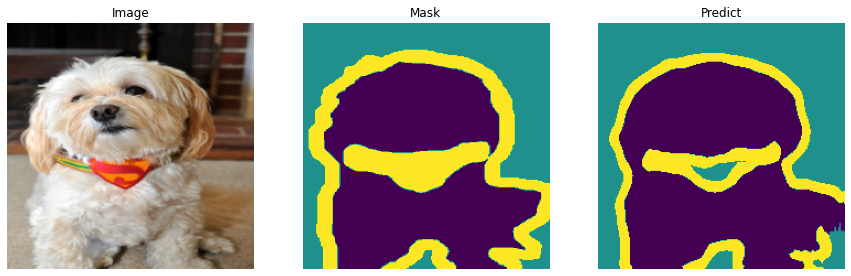

Current Step: 150 	Train Loss: 0.014760234355926515, Train Iou: 0.958926260471344


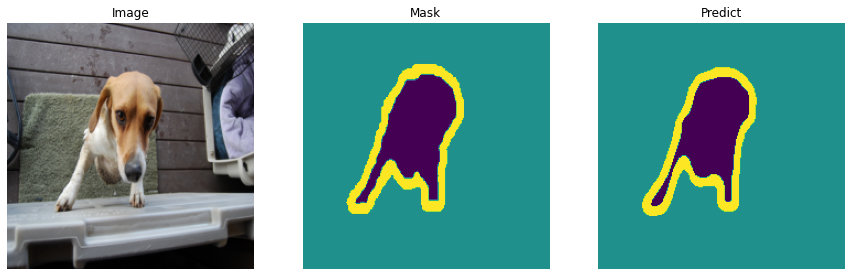

Current Step: 200 	Train Loss: 0.012471833825111389, Train Iou: 0.9585627913475037


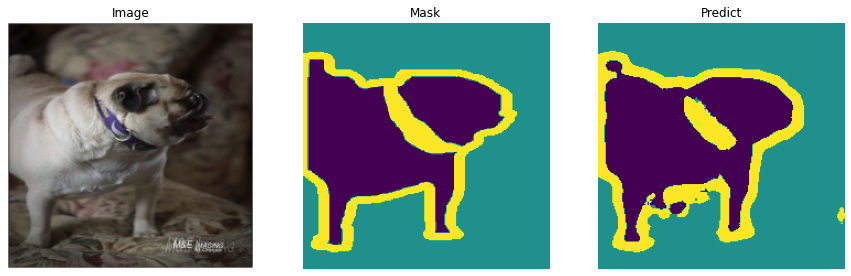

 Epoch: [27/30] - Validation
Validation step: Val Loss: 0.147004172205925, Val Iou: 0.9213265180587769


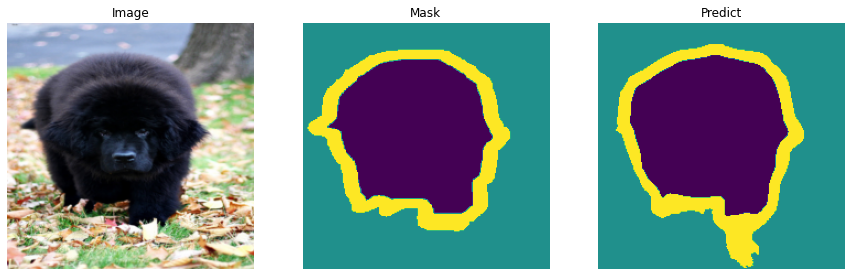

EarlyStopping counter: 6 out of 7
 Epoch: [28/30] - Train
Current Step: 50 	Train Loss: 0.01203234240412712, Train Iou: 0.9598129391670227


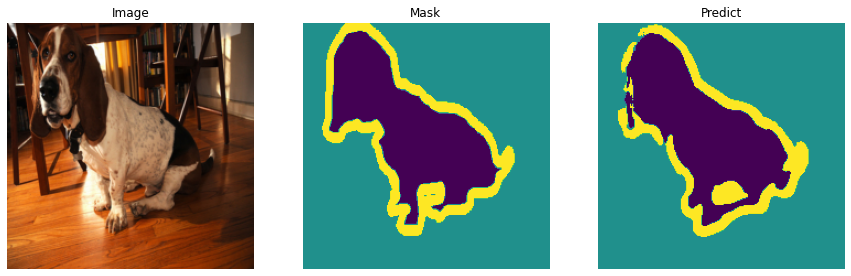

Current Step: 100 	Train Loss: 0.0020911721885204316, Train Iou: 0.9610419273376465


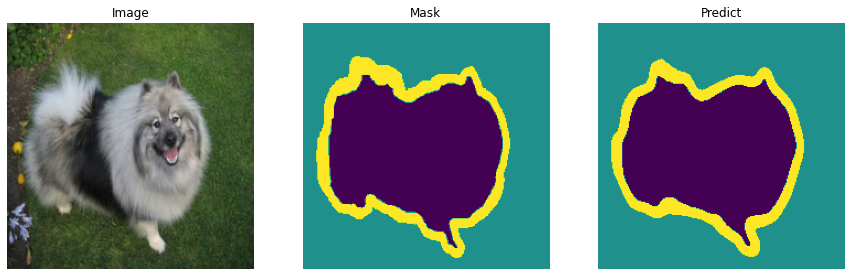

Current Step: 150 	Train Loss: 0.03160296469926834, Train Iou: 0.9504688382148743


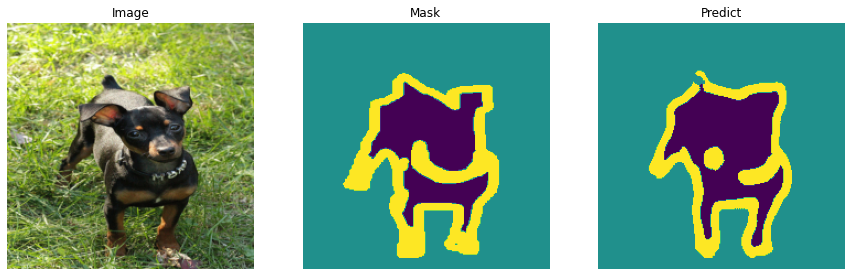

Current Step: 200 	Train Loss: 0.029629832506179808, Train Iou: 0.9517260193824768


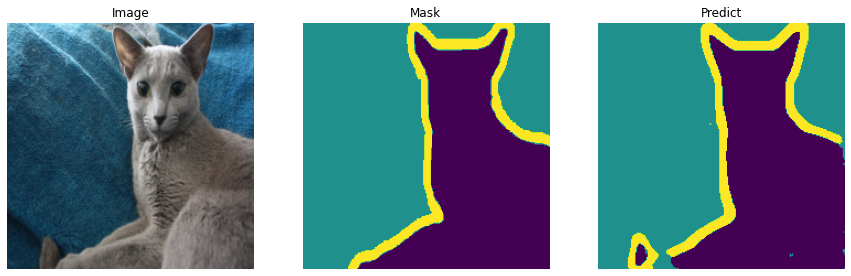

 Epoch: [28/30] - Validation
Validation step: Val Loss: 0.12871098518371582, Val Iou: 0.9215187430381775


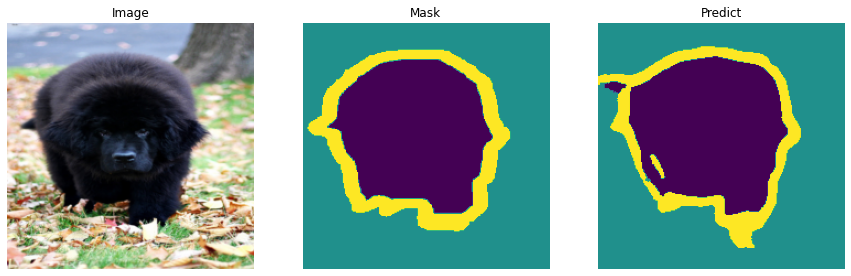

EarlyStopping counter: 7 out of 7


In [ ]:
train_result = []
val_result = []

early_stopper = EarlyStopping(
    patience=7, verbose=True, path=os.path.join(model_path, "model.ckpt")
)


for epoch in range(1, epochs + 1):
    train_loss, train_iou = train(epoch, model, train_loader, loss_fn, optimizer)
    val_loss, val_iou = validation(epoch, model, val_loader, loss_fn)
    
    early_stopper(val_loss, model)
    if early_stopper.early_stop:
        break

    train_result.append([train_loss, train_iou])
    val_result.append([val_loss, val_iou])

# Visualization Loss & IOU

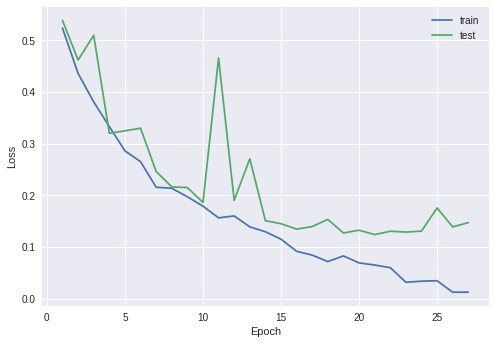

In [ ]:
plt.style.use('seaborn')
plt.plot([i for i in range(1, len(train_result) + 1)], [i[0] for i in train_result])
plt.plot([i for i in range(1, len(val_result) + 1)], [i[0] for i in val_result])
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend(["train", "test"])
plt.show()

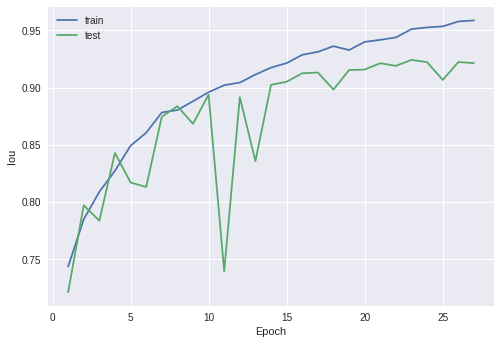

In [ ]:
plt.plot([i for i in range(1, len(train_result) + 1)], [i[1] for i in train_result])
plt.plot([i for i in range(1, len(val_result) + 1)], [i[1] for i in val_result])
plt.xlabel("Epoch")
plt.ylabel("Iou")
plt.legend(["train", "test"])
plt.show()

# Test Model

Test Iou:  tensor(0.8879)


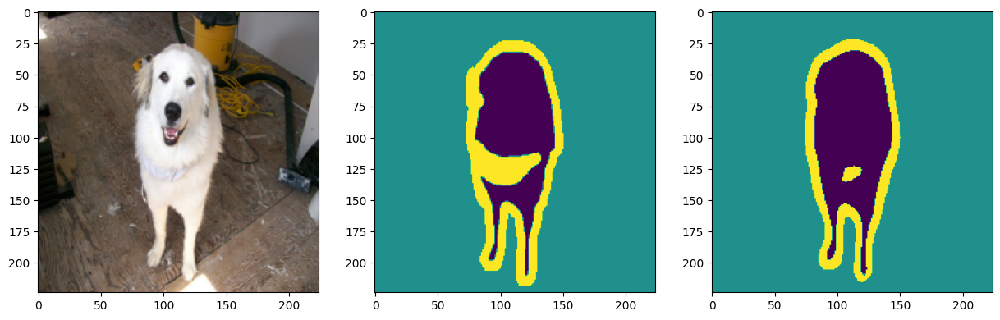

In [ ]:
image, mask = next(iter(val_loader))
img, msk = image[2], mask[2]

plt.style.use('default')
plt.figure(figsize=(15, 15))
plt.subplot(131)
plt.imshow(torch.permute(img, (1, 2, 0)))
plt.subplot(132)


msk = torch.squeeze(msk, 0)
plt.imshow(msk)

model.eval()
out = model(torch.unsqueeze(img, 0).to(device))
print('Test Iou: ', iou(out, msk))

out = F.softmax(out, 1)
out = torch.squeeze(out, 0)
_, out = torch.max(out, 0)


plt.subplot(133)
plt.imshow(out.detach().cpu().numpy())
plt.show()